#### This notebook is used to update the figures used in the BMI1+ manuscript. The version of Python used here is 3.10.12 with scanpy 1.9.3.

In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

import warnings
warnings.filterwarnings("ignore")

import scanpy as sc
import PlotGenerators as helper

import importlib
importlib.reload(helper)

import matplotlib.pyplot as plt
from matplotlib_venn import venn3
import pandas as pd
import numpy as np
from scpy4reactome import pathway_analyzer as pa

DIR_NAME = '/Volumes/ssd/results/missy_sc_rna/bmi1/E15.5/'
figure_file_dir = '{}../manuscript_figures_10302023/'.format(DIR_NAME)
# figure_file_template = '{}manuscript_figures_09142023/{}.tiff'
# figure_file_template = '{}../manuscript_figures_10022023/{}.tiff'
# figure_file_template = '{}../manuscript_figures_10232023/{}.tiff'
# figure_file_template = '{}../manuscript_figures_10302023/{}.tiff'
figure_file_template = '{}../manuscript_figures_11142023/{}.tiff'

Reactome_GMT_File = '../resources/MouseReactomePathways_Rel_75_122220.gmt'

In [6]:
# Figure 5A: UMAP of the harmonized three time point data
# The following file was generated by another notebook, harmony_integration.ipynb
filename = '../resources/harmony_frozen.h5ad'
adata_harmony = sc.read(filename)

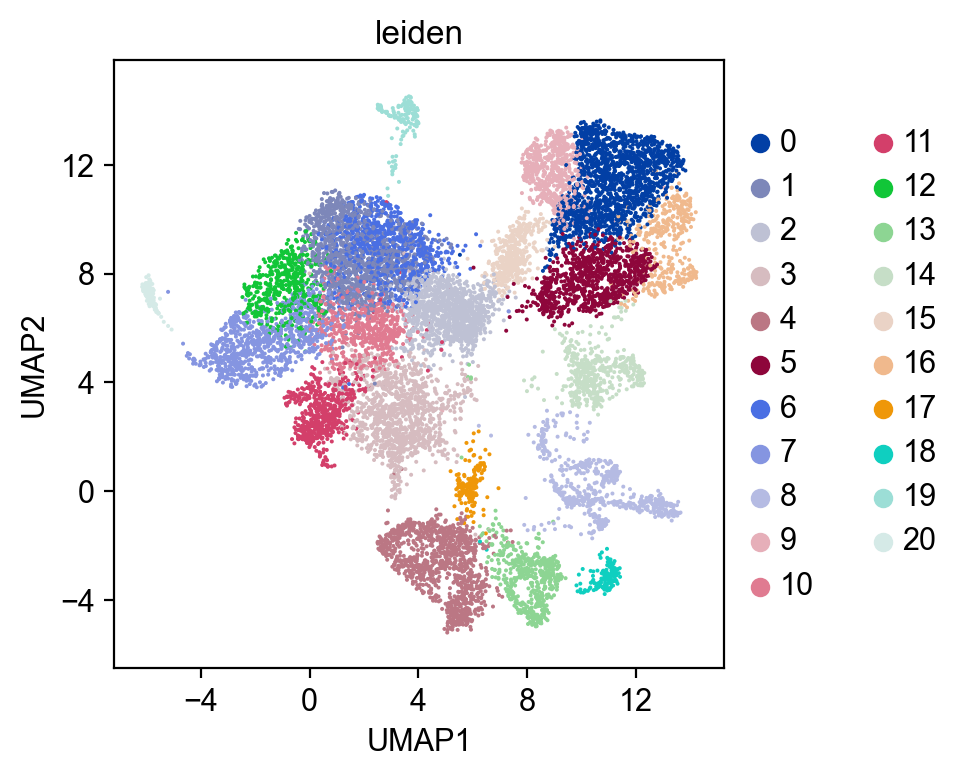

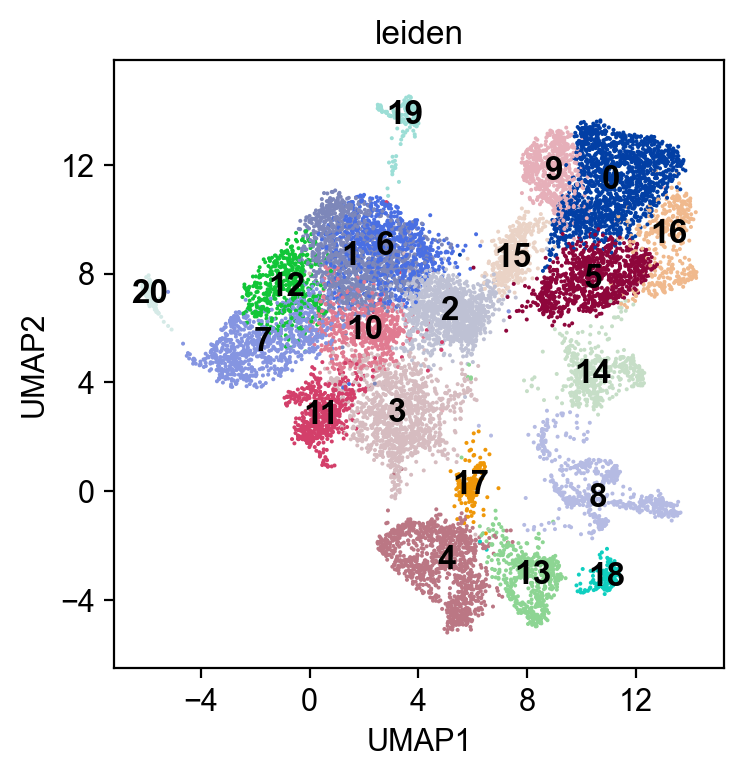

In [6]:
# Plot clusters
plot = sc.pl.umap(adata_harmony, color='leiden', show=False)
plot = helper.squarify_umap(plot, adata_harmony)
plt.savefig(figure_file_template.format(DIR_NAME, 'harmony_clusters'), bbox_inches='tight', dpi=495, facecolor='white')

plot = sc.pl.umap(adata_harmony, color='leiden', show=False, legend_loc='on data')
plot = helper.squarify_umap(plot, adata_harmony)
plt.savefig(figure_file_template.format(DIR_NAME, 'harmony_clusters_legend_on_data'), bbox_inches='tight', dpi=495, facecolor='white')

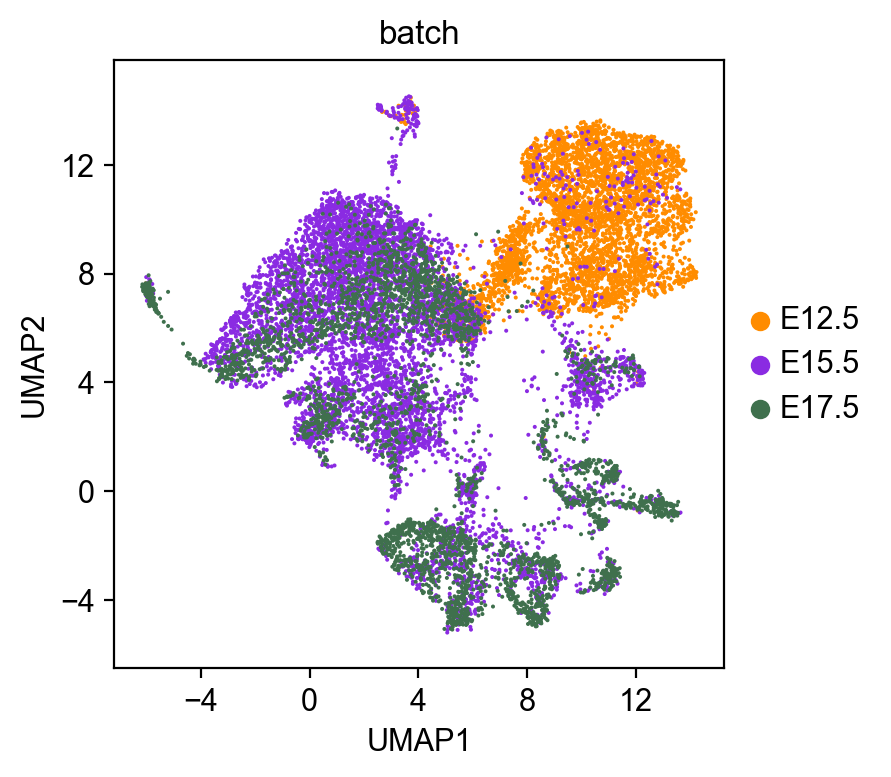

In [6]:
# The following color was set by Missy
# E12.5 FF8C00
# E12.5 stem FF6700
# E15.5 8A2BE2
# E15.5 stem 51087E
# E17.5 3F704D
# E17.5 stem 004225
adata_harmony.uns['batch_colors'] = ['#FF8C00', '#8A2BE2', '#3F704D']
plot = sc.pl.umap(adata_harmony, color='batch', show=False)
plot = helper.squarify_umap(plot, adata_harmony)
plt.savefig(figure_file_template.format(DIR_NAME, 'Fig5A'), bbox_inches='tight', dpi=495, facecolor='white')
# del adata_harmony

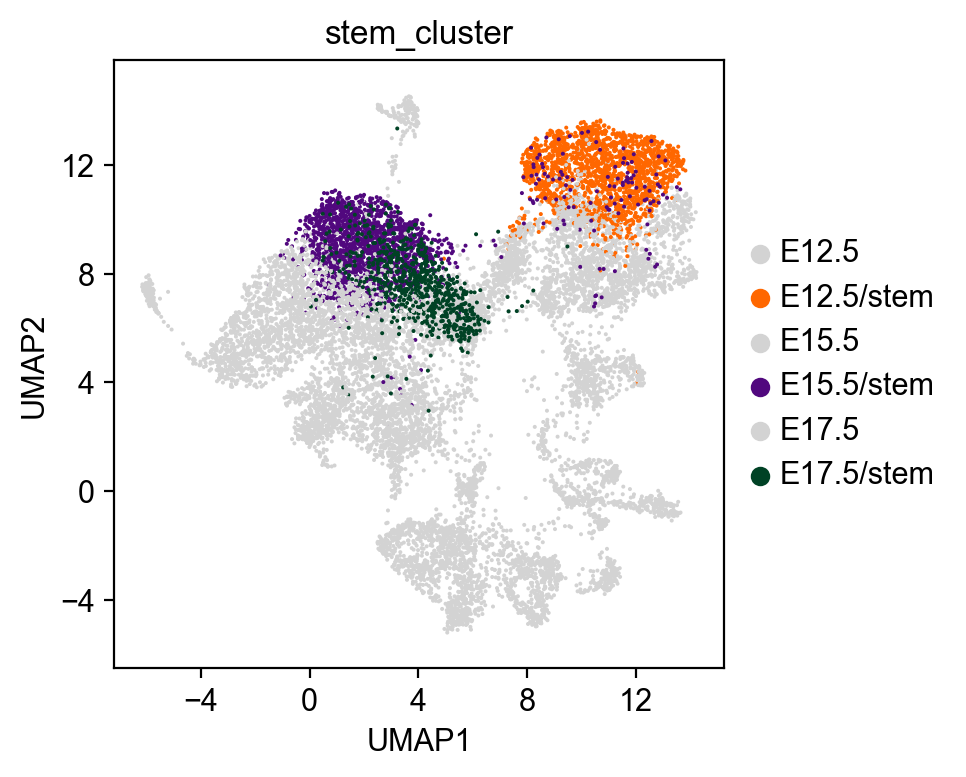

In [4]:
# The following code is used to generate Figure S5G, Venn diagrams and Figure S5H, stem labels with inclusion of E15.5 data.
stem_clusters_all = {
    'E12.5': ['1'],
    'E15.5': ['0', '1'],
    'E17.5': ['0', '4']
}
def create_stem_cluster(row):
    if not pd.isna(row['leiden_E12']):
        return 'E12.5/stem' if row['leiden_E12'] in stem_clusters_all['E12.5'] else 'E12.5'
    elif not pd.isna(row['leiden_E15']):
        return 'E15.5/stem' if row['leiden_E15'] in stem_clusters_all['E15.5'] else 'E15.5'
    elif not pd.isna(row['leiden_E17']):
        return 'E17.5/stem' if row['leiden_E17'] in stem_clusters_all['E17.5'] else 'E17.5'
    else:
        return None
adata_harmony.obs['stem_cluster'] = adata_harmony.obs.apply(create_stem_cluster, axis=1)

# Need to specify colors
# adata_harmony.uns['stem_cluster_colors'] = ['#FF8C00', '#FF6700', '#8A2BE2', '#51087E', '#3F704D', '#004225']
# As of November 7, 2023, change no stem cells to light grey
adata_harmony.uns['stem_cluster_colors'] = ['#D3D3D3', '#FF6700', '#D3D3D3', '#51087E', '#D3D3D3', '#004225']
plot = sc.pl.umap(adata_harmony, color = ['stem_cluster'], show=False)
plot = helper.squarify_umap(plot, adata_harmony)
plt.savefig(figure_file_template.format(DIR_NAME, 'FigS5H'), bbox_inches='tight', dpi=495, facecolor='white')

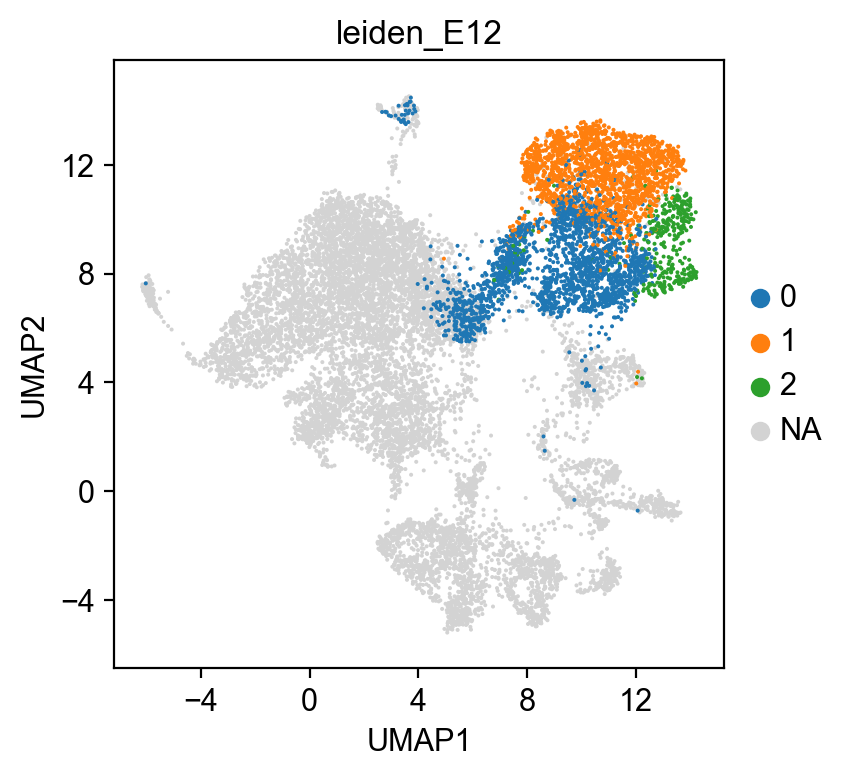

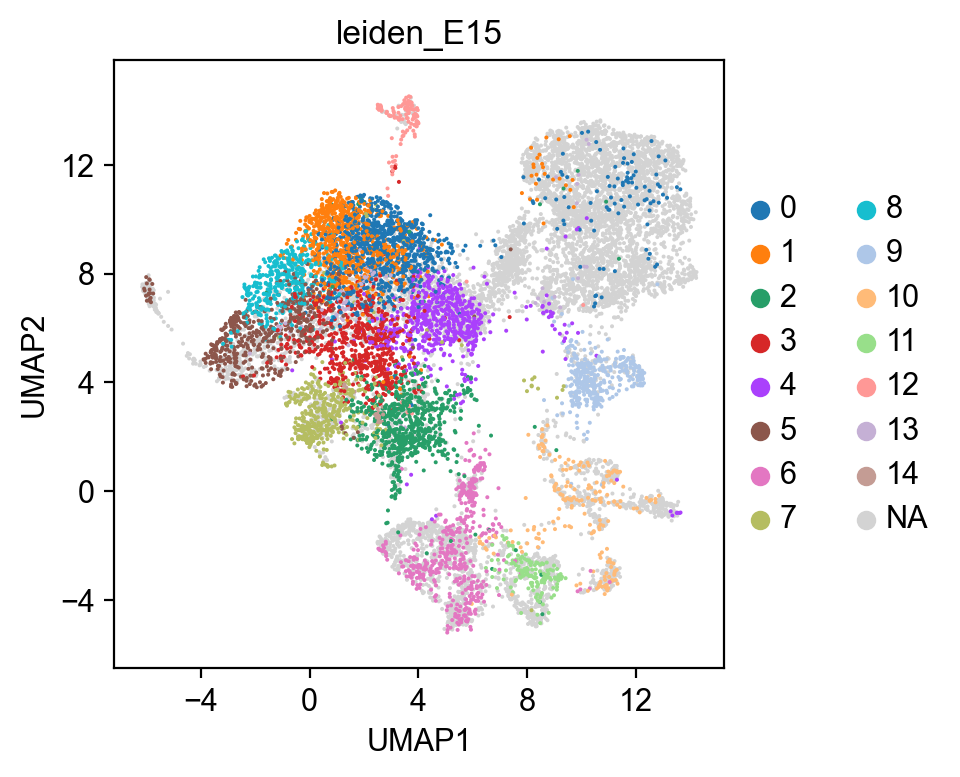

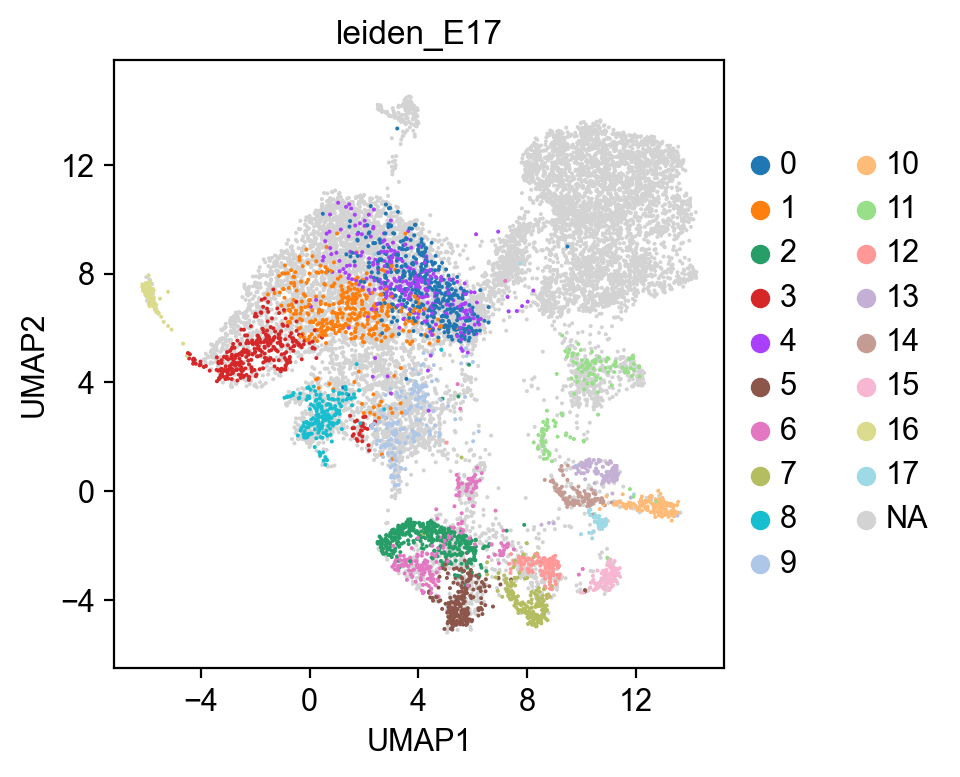

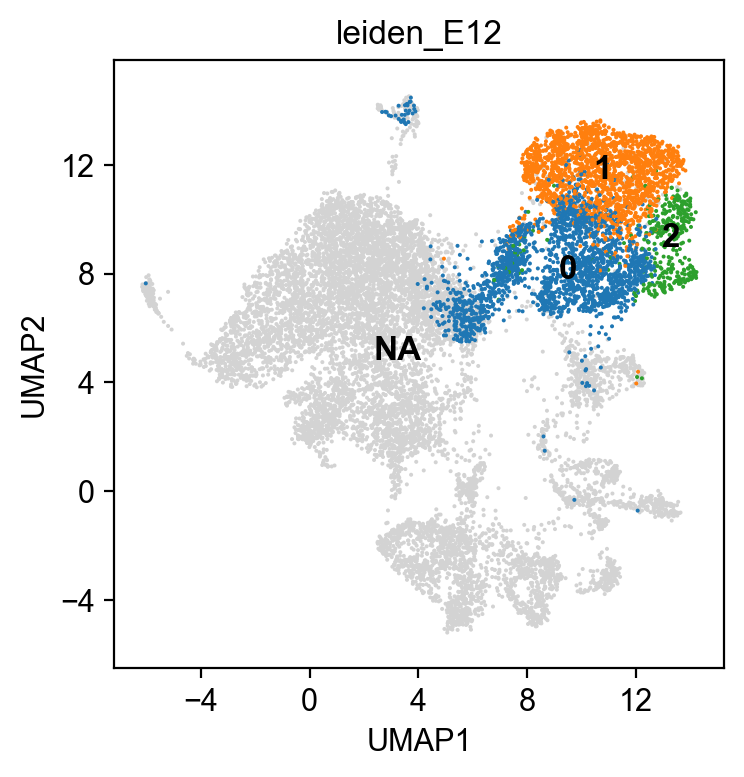

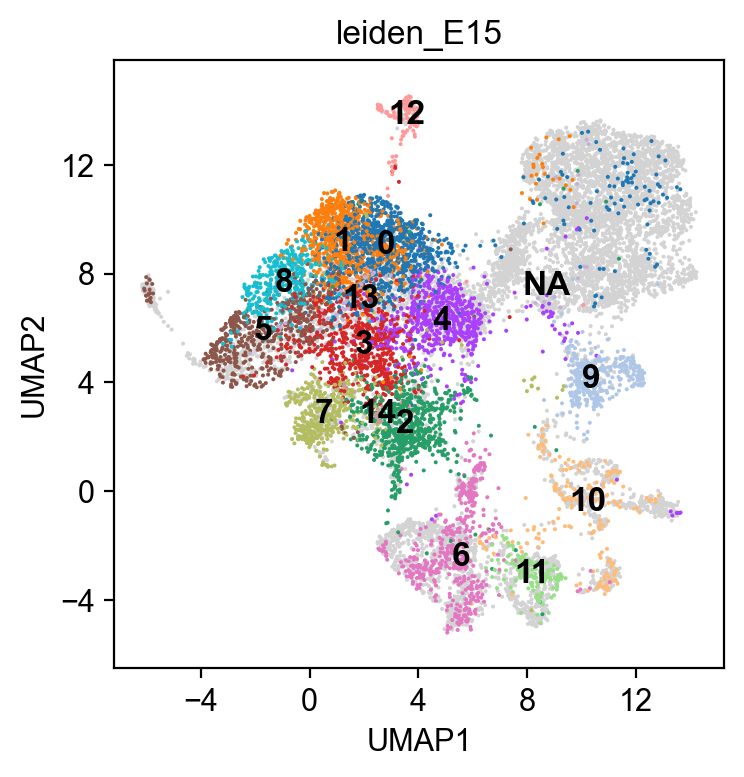

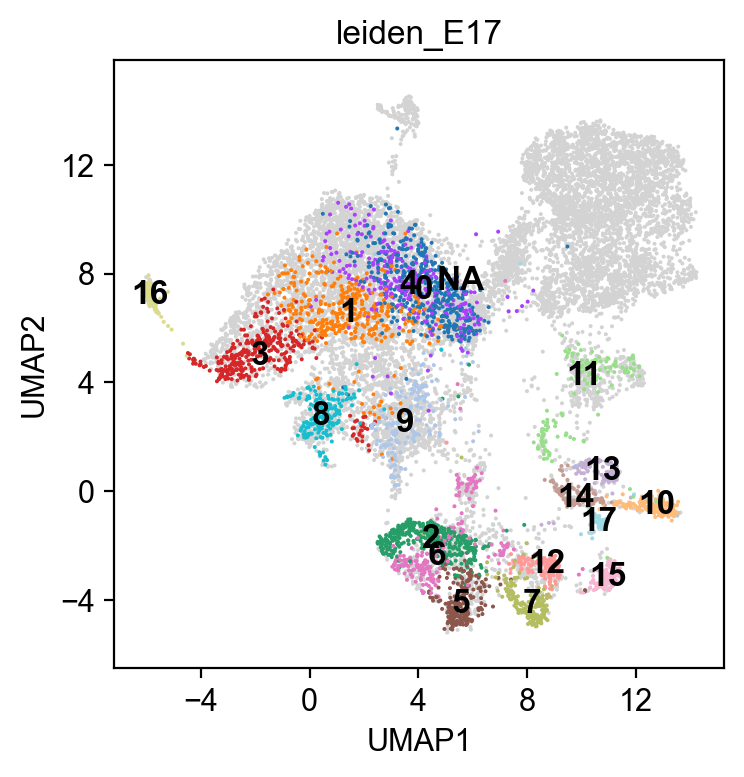

In [14]:
# Plot clusters from individual time points in the harmony map
leiden_key_names = ['leiden_E12', 'leiden_E15', 'leiden_E17']
for leiden_key_name in leiden_key_names:
    plot = sc.pl.umap(adata_harmony, color = leiden_key_name, show=False)
    plot = helper.squarify_umap(plot, adata_harmony)
    plt.savefig(figure_file_template.format(DIR_NAME, '{}_in_harmony'.format(leiden_key_name)), bbox_inches='tight', dpi=495, facecolor='white')
for leiden_key_name in leiden_key_names:
    plot = sc.pl.umap(adata_harmony, color = leiden_key_name, show=False, legend_loc='on data')
    plot = helper.squarify_umap(plot, adata_harmony)
    plt.savefig(figure_file_template.format(DIR_NAME, '{}_in_harmony_on_data'.format(leiden_key_name)), bbox_inches='tight', dpi=495, facecolor='white')

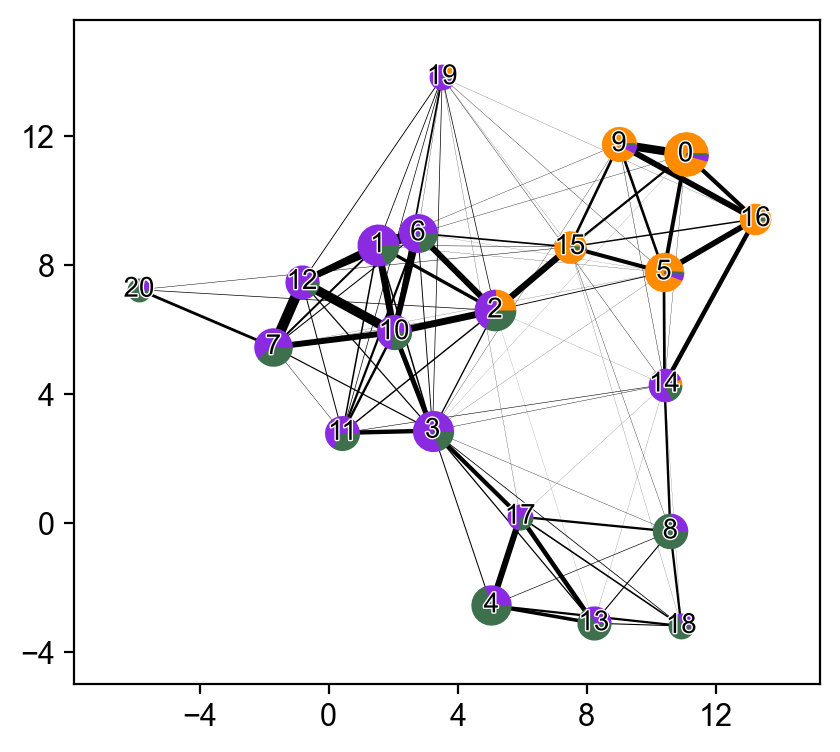

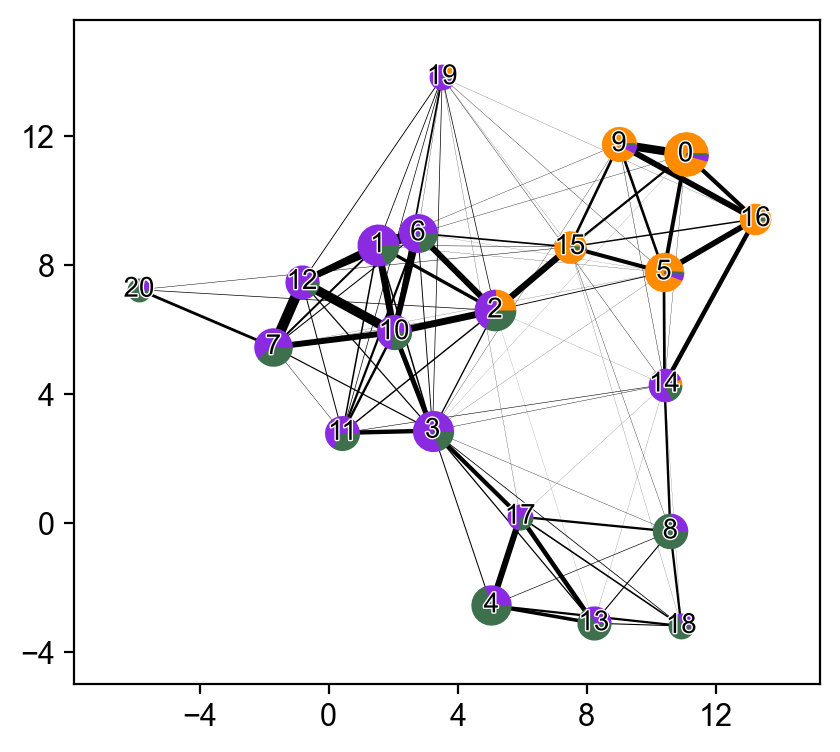

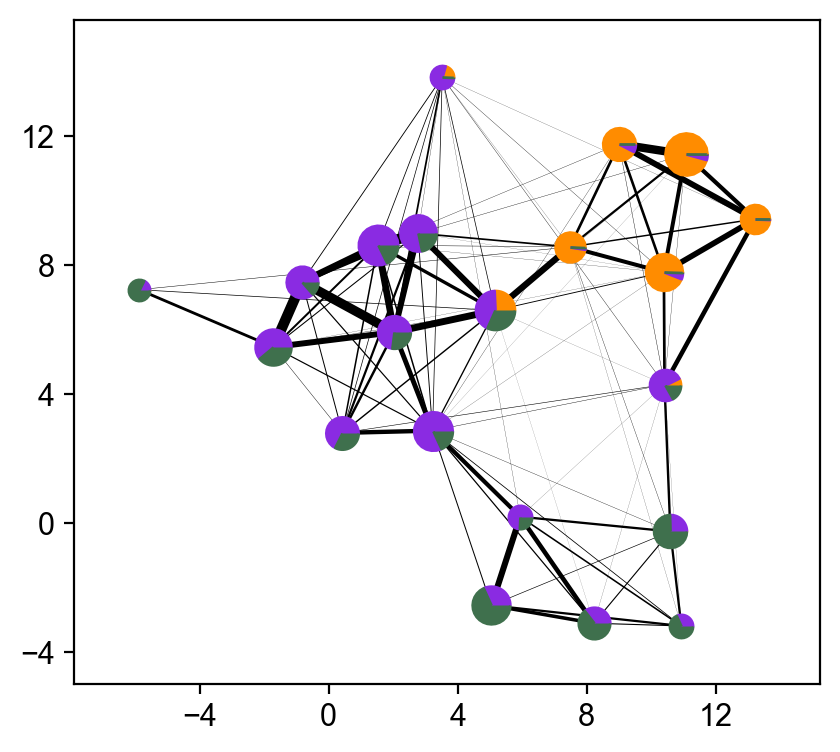

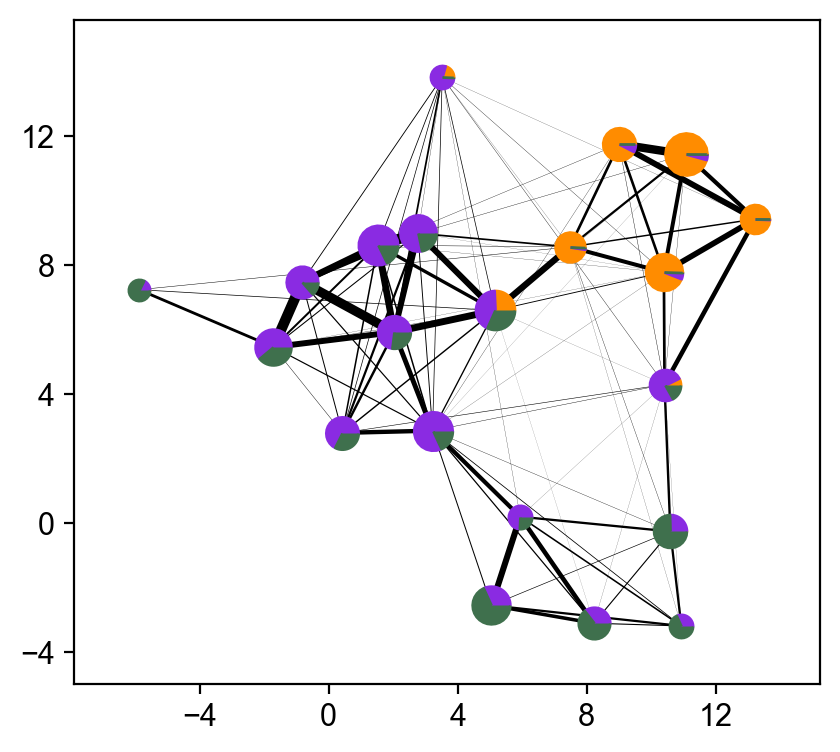

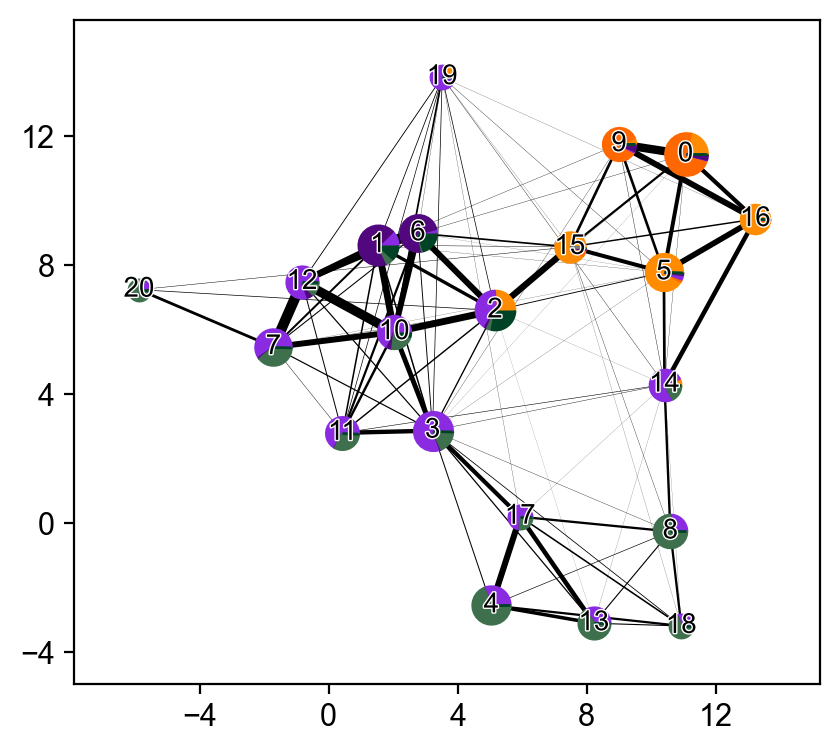

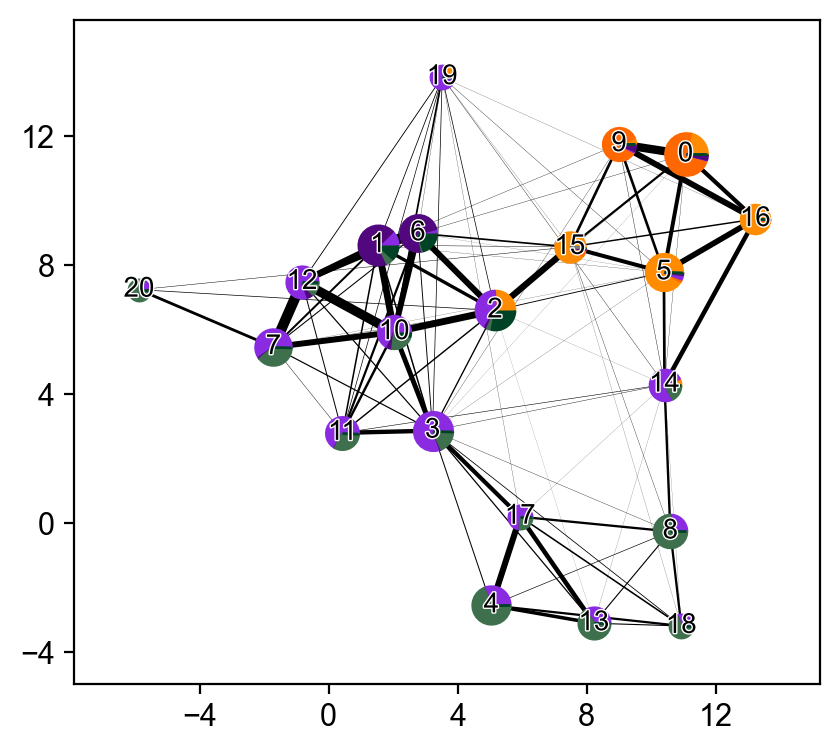

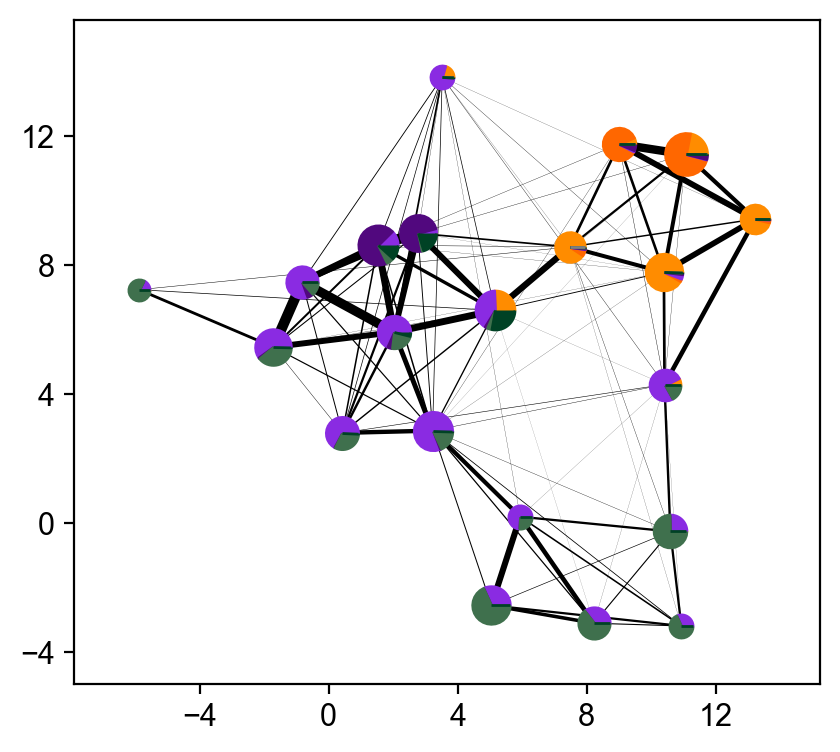

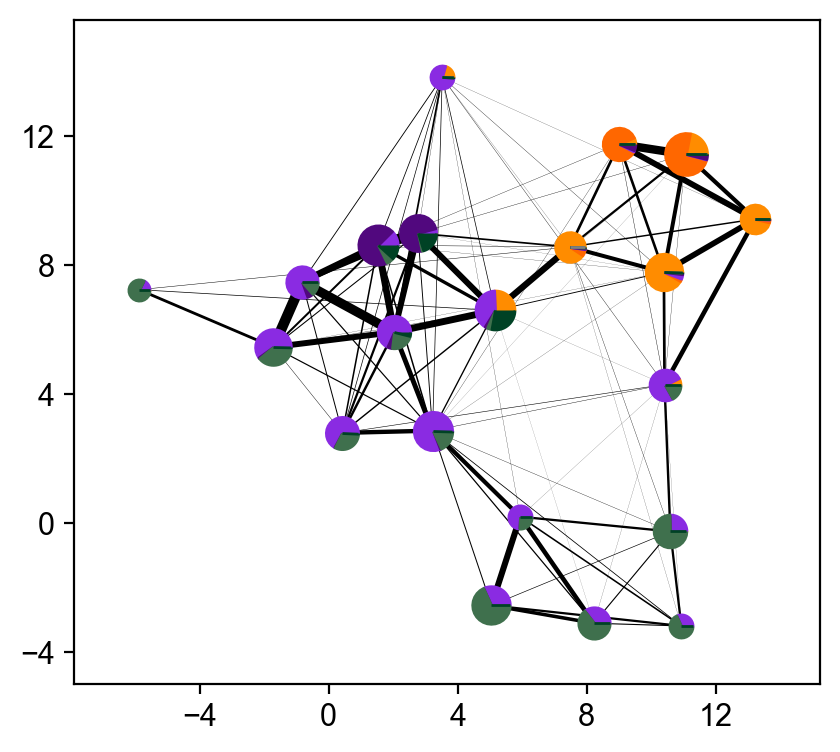

In [85]:
# PAGA plot with cytotrace overlaid: This function is modified from the below.
def plot_harmony_paga(adata: sc.AnnData,
                      color_key: str='batch',
                      no_label: bool=True,
                      fig_filename: str = None,
                      table_filename: str = None):
    labels = None
    if no_label:
        labels = [''] * len(adata.obs['leiden'].unique())
    plot = sc.pl.paga(adata,
            #threshold=0.09,
            color = color_key,
            pos = adata.uns['paga']['pos'],
            cmap = 'viridis',
            #fontsize=0,
            edge_width_scale=0.5,
            random_state=helper.random_state,
            labels=labels,
            fontoutline=1,
            fontweight='normal',
            fontsize=10,
            show=False)
    plot.set(adjustable='box', aspect='equal')
    # cbar = plot.figure.properties()['default_bbox_extra_artists'][1]
    # cbar.set_position((0.68,0.08,0.03,0.8)) # Manually determined
    fig = plot.figure

    # The following ticks are based on the previous UMAP and set manually
    plot.xaxis.set_ticks([-4, 0, 4, 8, 12])
    plot.xaxis.set_tick_params(reset=True, which='major', top=False)
    plot.yaxis.set_ticks([-4, 0, 4, 8, 12])
    plot.yaxis.set_tick_params(reset=True, which='major', right=False)

    # for i in range(14):
    #     fig.properties()['default_bbox_extra_artists'][3].set_visible(False) # se idx 3 for removing leiden text
    if fig_filename is not None:
        dummy = plt.figure()
        new_manager = dummy.canvas.manager
        new_manager.canvas.figure = plot.figure
        fig.set_canvas(new_manager.canvas)
        plt.savefig(fig_filename, bbox_inches='tight', dpi=600, facecolor='white')

    # Dump the percentages and cell numbers in each cluster for each batch
    if table_filename is not None:
        df = build_df_for_batch_in_clusters(adata, color_key)
        df.to_csv(table_filename)


def build_df_for_batch_in_clusters(adata: sc.AnnData,
                                   batch_key: str) -> pd.DataFrame:
    # Just two columns
    df = adata.obs[['leiden', batch_key]]
    df['cell'] = df.index
    df = df.pivot_table(index='leiden', columns=batch_key, values='cell', aggfunc='count', fill_value=0)
    df.reset_index(drop=True, inplace=True)
    row_sums = df.sum(axis=1)
    # Get the percentage
    percentage_df = df.div(row_sums, axis=0) * 100
    percentage_df.columns = ['{}_Percentage'.format(col) for col in percentage_df.columns]
    # Merge them together
    result_df = pd.concat([df, percentage_df], axis=1)
    # Change the col names
    result_df.columns = ['{}_Cells'.format(col) if col in df.columns else col for col in result_df.columns]
    result_df['Total_Cells'] = row_sums
    result_df.index.rename('leiden', inplace=True)
    return result_df

# df = build_df_for_batch_in_clusters(adata_harmony, batch_key='batch')
# df

plot_harmony_paga(adata_harmony, no_label=False, 
                  fig_filename=figure_file_template.format(DIR_NAME, 'harmony_paga_batch_label'),
                  table_filename=DIR_NAME + '../manuscript_figures_10232023/harmony_paga_batch_cell_counts.csv')
plot_harmony_paga(adata_harmony, no_label=True, 
                  fig_filename=figure_file_template.format(DIR_NAME, 'harmony_paga_batch_no_label'))
plot_harmony_paga(adata_harmony, color_key='stem_cluster', no_label=False, 
                  fig_filename=figure_file_template.format(DIR_NAME, 'harmony_paga_batch_stem_label'),
                  table_filename=DIR_NAME + '../manuscript_figures_10232023/harmony_paga_batch_stem_cell_counts.csv')
plot_harmony_paga(adata_harmony, color_key='stem_cluster', no_label=True, 
                  fig_filename=figure_file_template.format(DIR_NAME, 'harmony_paga_batch_stem_no_label'))
# sc.pl.paga(adata_harmony, color=['leiden', 'batch'], pos=adata_harmony.uns['paga']['pos'])

Marker genes for E12.5: 
341


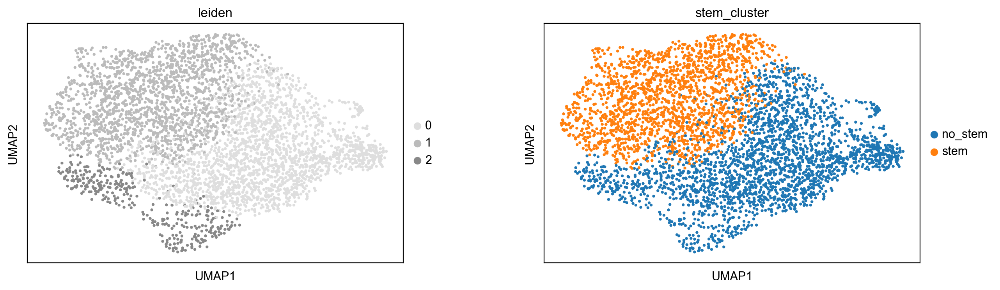

Marker genes for E15.5: 
734


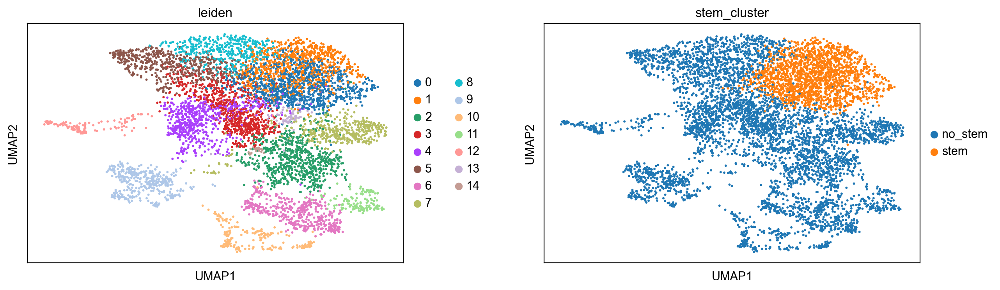

Marker genes for E17.5: 
1620


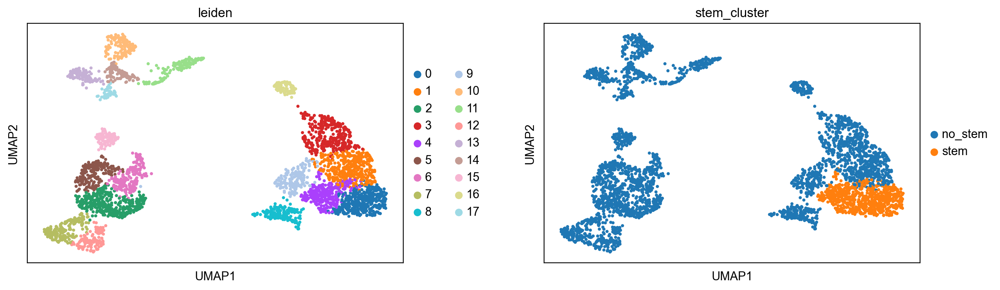

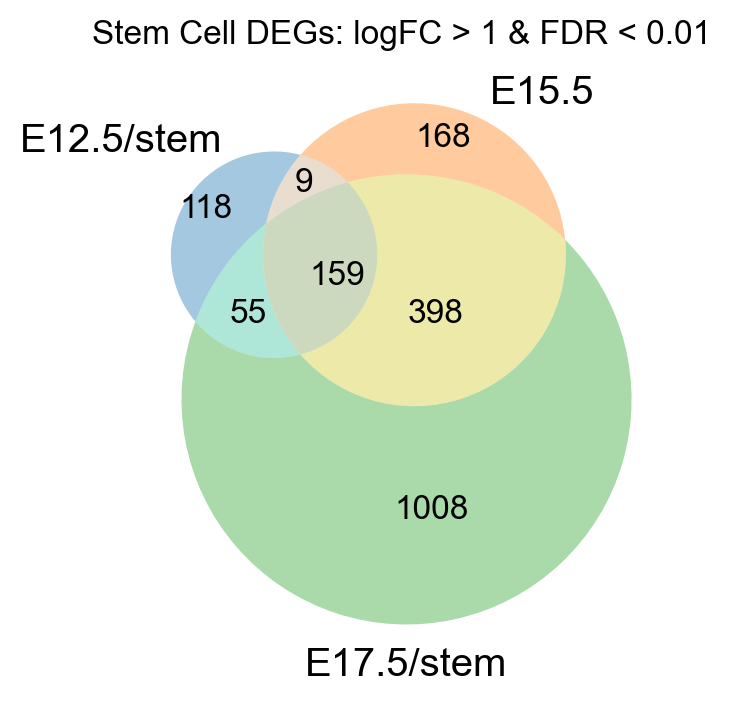

In [7]:
# Plot Figure S5G for stem cell markers overlapping using Venn diagram
# Load the data, assing stem clusters and then calculate markers genes
times = ['E12.5', 'E15.5', 'E17.5']
adata_files = ['../resources/adata_12_frozen.h5ad',
               '../resources/adata_15_frozen.h5ad',
               '../resources/adata_17_frozen.h5ad']
index = 0
markers = []
for adata_file in adata_files:
    adata = sc.read_h5ad(adata_file)
    # Need a little bit fix for key error
    if ('log1p' in adata.uns.keys()) and ('base' not in adata.uns['log1p'].keys()):
        adata.uns['log1p']['base'] = 2
    time = times[index]
    stem_clusters = stem_clusters_all[time]
    adata.obs['stem_cluster'] = adata.obs['leiden'].map(lambda c: 'stem' if c in stem_clusters else 'no_stem')
    sc.tl.rank_genes_groups(adata, groupby='stem_cluster', groups=['stem'])
    # Following the original thresholds set by Patrick
    markers_time = set(sc.get.rank_genes_groups_df(adata, group='stem', log2fc_min=1, pval_cutoff=0.01)['names'].to_list())
    # print(markers_time)
    print('Marker genes for {}: \n{}'.format(time, len(markers_time)))
    markers.append(markers_time)
    sc.pl.umap(adata, color=['leiden', 'stem_cluster'], wspace=0.25)
    index += 1

# Plot Venn diagram
venn3(markers,
      set_labels = ('E12.5/stem', 'E15.5', 'E17.5/stem'), 
      set_colors=adata_harmony.uns['batch_colors'])
plt.title("Stem Cell DEGs: logFC > 1 & FDR < 0.01")
plt.savefig(figure_file_template.format(DIR_NAME, 'FigS5G'), bbox_inches='tight', dpi=495, facecolor='white')

In [14]:
# Generate the genes and calculate p-values based on Fisher Exact test
all_shared = None
for markers_time in markers:
    if all_shared is None:
        all_shared = set(markers_time)
    else:
        all_shared = all_shared & set(markers_time)
print('Shared in all: {}'.format(len(all_shared)))
all_shared_file_name = figure_file_dir + 'shared_all_stem_genes.txt'
with open(all_shared_file_name, 'w') as file:
    for gene in all_shared:
        file.write(gene + '\n')

Shared in all: 159


In [24]:
# Fisher exact test
from scipy.stats import fisher_exact

total_genes = adata_harmony.shape[1]
times = ('E12.5', 'E15.5', 'E17.5')
fisher_test_df = pd.DataFrame(columns=['Comparison', 'odds_ratio', 'p-value', 'marker_genes_1', 'marker_genes_2', 'marker_genes_shared'])
for i in range(len(times) - 1):
    time1 = times[i]
    markers1 = markers[i]
    for j in range(i + 1, len(times)):
        time2 = times[j]
        markers2 = markers[j]
        markers_shared = set(markers1) & set(markers2)
        # Create a 2x2 contingency table
        # Example data:
        #            Group 1   Group 2
        # Outcome 1     A         B
        # Outcome 2     C         D
        shared_len = len(markers_shared)
        odds_ratio, p_value = fisher_exact([[shared_len, len(markers1) - shared_len], 
                                            [len(markers2) - shared_len, total_genes - len(markers1) - len(markers2) + shared_len]])
        df_row = ['{} vs {}'.format(time1, time2),
                  odds_ratio,
                  p_value,
                  len(markers1),
                  len(markers2),
                  shared_len]
        fisher_test_df.loc[len(fisher_test_df.index)] = df_row

display(fisher_test_df)

fisher_test_df_file_name = figure_file_dir + 'stem_genes_fisher_exact_test_result.csv'
fisher_test_df.to_csv(fisher_test_df_file_name, index=None)

,Comparison,odds_ratio,p-value,marker_genes_1,marker_genes_2,marker_genes_shared
0,E12.5 vs E15.5,25.933128,8.952293e-136,341,734,168
1,E12.5 vs E17.5,17.108063,3.500035e-128,341,1620,214
2,E15.5 vs E17.5,42.111522,0.000000e+00,734,1620,557


In [ ]:
%%script false --no-raise-error
# Fig 5D: UMAP colored with colors and CytoTRACE. Note: CytoTRACE was calculated by the Web Server.
# Generate a matrix of E15.5 to submit to the web server: https://cytotrace.stanford.edu. 
# To do this, the original raw counts are reloaded
# The following code was copied from Patric's bmi1-processing.py.
raw_count_dir_15_5 = DIR_NAME + '/aligned_outs/filtered_feature_bc_matrix'
adata_15_cytotrace = helper.open_data(raw_count_dir_15_5)
# Dump the counts
adata_15_cytotrace.X = adata_15_cytotrace.layers['counts']
adata_15_cytotrace_df = adata_15_cytotrace.to_df()
out_file_name = DIR_NAME + 'filtered_counts_e15_5.csv'
adata_15_cytotrace_df.transpose().to_csv(out_file_name)
del adata_15_cytotrace
del adata_15_cytotrace_df

cytotrace and adata have different numbers of cells
Found root_cell: ACTGATGGTCATCTAG-1


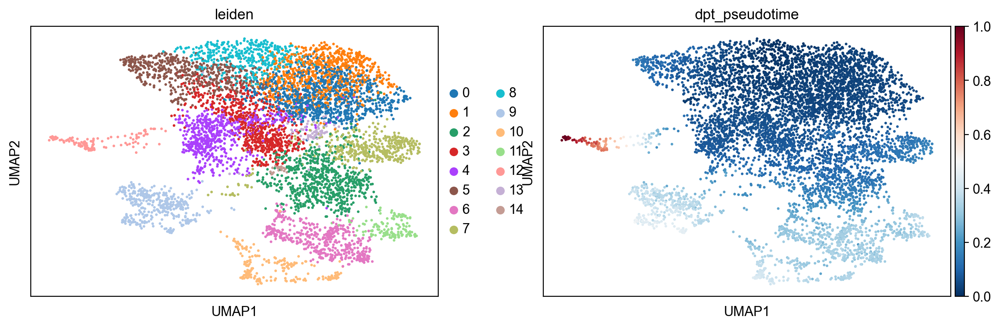

In [ ]:
# %%script false --no-raise-error
# Output from the cytotrace web server was downaded as the following file
cytotrace_server_result_file = DIR_NAME + 'CytoTRACE_results_filtered_counts_e15_5.txt'
cyto_df = pd.read_csv(cytotrace_server_result_file, index_col=0, delimiter='\t')
cyto_df.index = cyto_df.index.str.replace('.','-')

# The processed adata is needed for merging
adata = sc.read_h5ad('../resources/adata_15_frozen.h5ad')
# cyto_df may have more cells
if adata.shape[0] != cyto_df.shape[0]:
    print('cytotrace and adata have different numbers of cells')
adata.obs['CytoTRACE'] = cyto_df['CytoTRACE']
# Get root cell
root_cell = cyto_df.CytoTRACE.idxmax()
print('Found root_cell: {}'.format(root_cell))
adata.uns['iroot'] = np.flatnonzero(adata.obs_names==root_cell)[0]

sc.tl.dpt(adata)
sc.pl.umap(adata, color=['leiden', 'dpt_pseudotime'])

del cyto_df

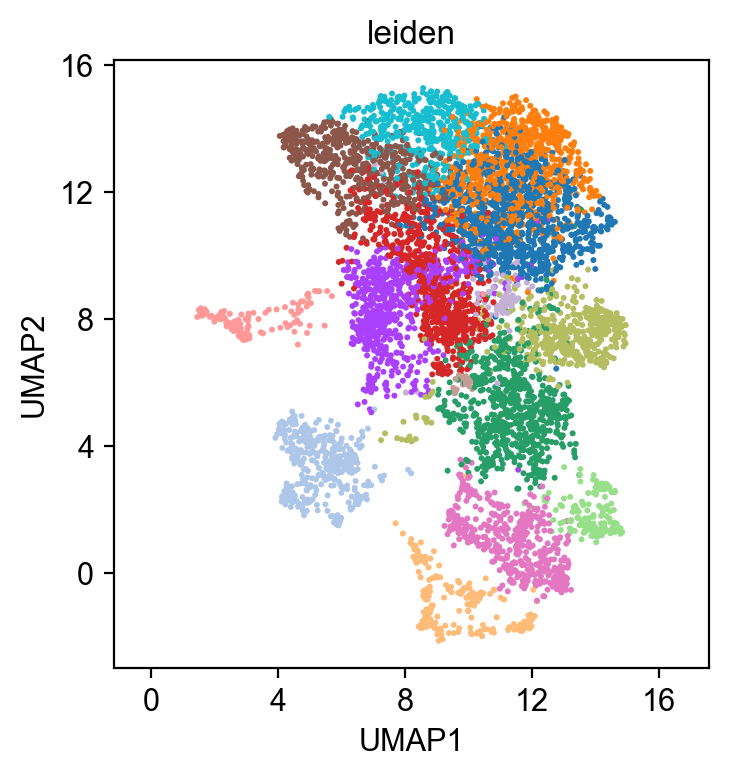

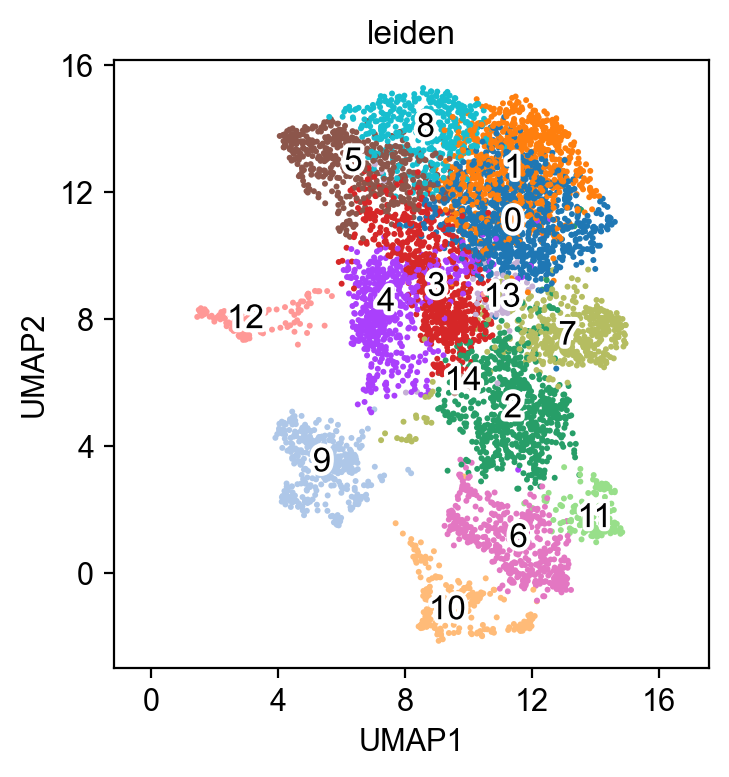

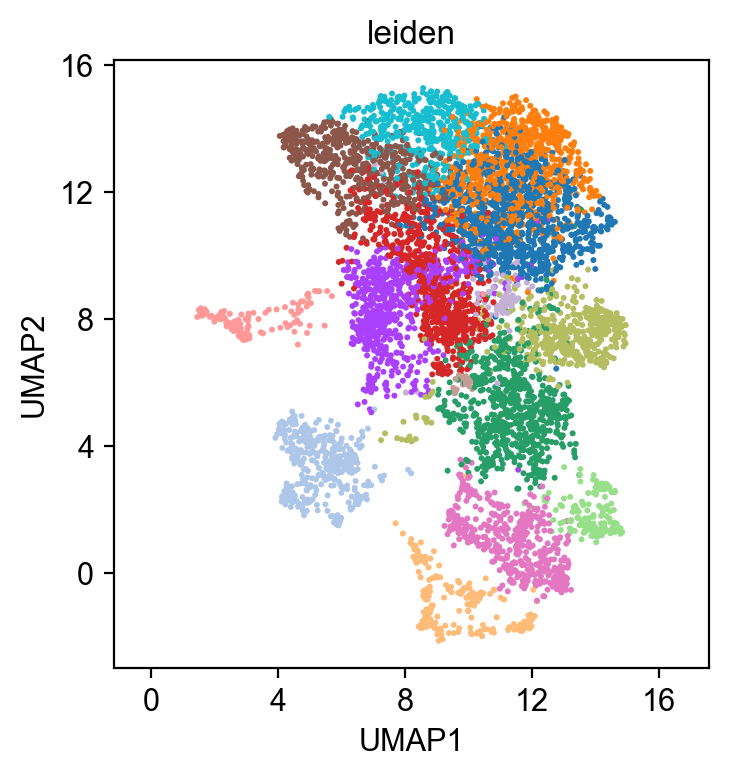

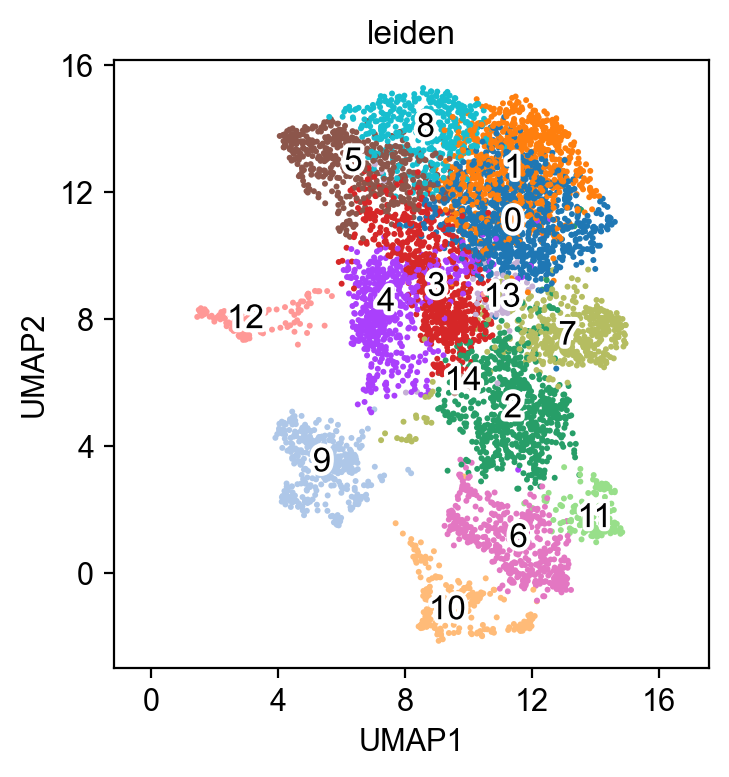

In [ ]:
# Plot UMAP colored with cluster and PAGA color by cytotrace
# The following code copied from figures.py
# UMAP with leiden cluster labeld
# adata = sc.read_h5ad('../resources/adata_15_frozen.h5ad')
# For E12.5 re-plot after removing clusters 3 and 4
# adata = sc.read_h5ad('../resources/adata_12_frozen.h5ad')

testplots = [sc.pl.umap(adata, color='leiden', legend_loc='None', show=False), # No label
             sc.pl.umap(adata, color='leiden', legend_loc='on data', show=False, legend_fontweight='normal', legend_fontsize=12, legend_fontoutline=3)]
labels = ['no_label', 'with_label']
for i in range(len(labels)):
    label = labels[i]
    plot = testplots[i]
    plot = helper.squarify_umap(plot, adata)
    fig = plot.figure
    dummy = plt.figure()
    new_manager = dummy.canvas.manager
    new_manager.canvas.figure = fig
    fig.set_canvas(new_manager.canvas)
    plt.savefig(figure_file_template.format(DIR_NAME, 'Fig4D_' + label), bbox_inches='tight', dpi=600, facecolor='white')

In [ ]:
# PAGA plot with cytotrace overlaid
def plot_paga(adata: sc.AnnData=adata,
              no_label: bool=True, 
              color: str='CytoTRACE',
              filename: str=figure_file_template.format(DIR_NAME, 'Fig4D_paga_cyto')):
    labels = None
    if no_label:
        labels = [''] * len(adata.obs['leiden'].unique())
    plot = sc.pl.paga(adata,
            #threshold=0.09,
            color = color,
            pos = adata.uns['paga']['pos'],
            cmap = 'viridis',
            root = adata.uns['iroot'],
            #fontsize=0,
            edge_width_scale=0.5,
            random_state=helper.random_state,
            labels=labels,
            fontoutline=1,
            fontweight='normal',
            fontsize=10,
            show=False)
    plot.set(adjustable='box', aspect='equal')
    cbar = plot.figure.properties()['default_bbox_extra_artists'][1]
    cbar.set_position((0.68,0.08,0.03,0.8)) # Manually determined
    fig = plot.figure

    # The following ticks are based on the previous UMAP and set manually
    plot.xaxis.set_ticks([-4, 0, 4, 8, 12])
    plot.xaxis.set_tick_params(reset=True, which='major', top=False)
    plot.yaxis.set_ticks([-4, 0, 4, 8, 12])
    plot.yaxis.set_tick_params(reset=True, which='major', right=False)

    # for i in range(14):
    #     fig.properties()['default_bbox_extra_artists'][3].set_visible(False) # se idx 3 for removing leiden text
    dummy = plt.figure()
    new_manager = dummy.canvas.manager
    new_manager.canvas.figure = plot.figure
    fig.set_canvas(new_manager.canvas)
    plt.savefig(filename, bbox_inches='tight', dpi=600, facecolor='white')

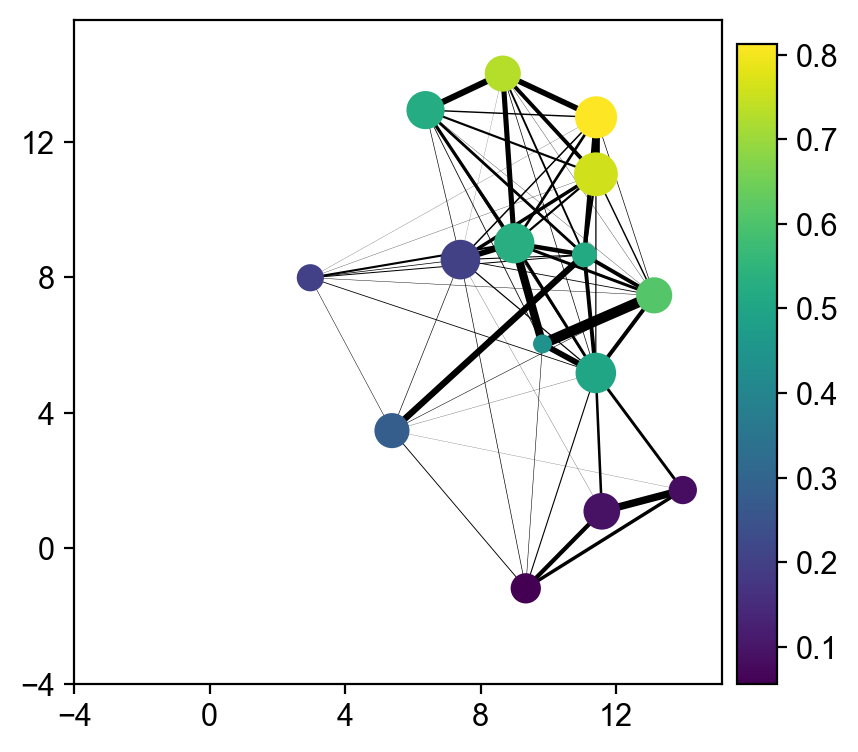

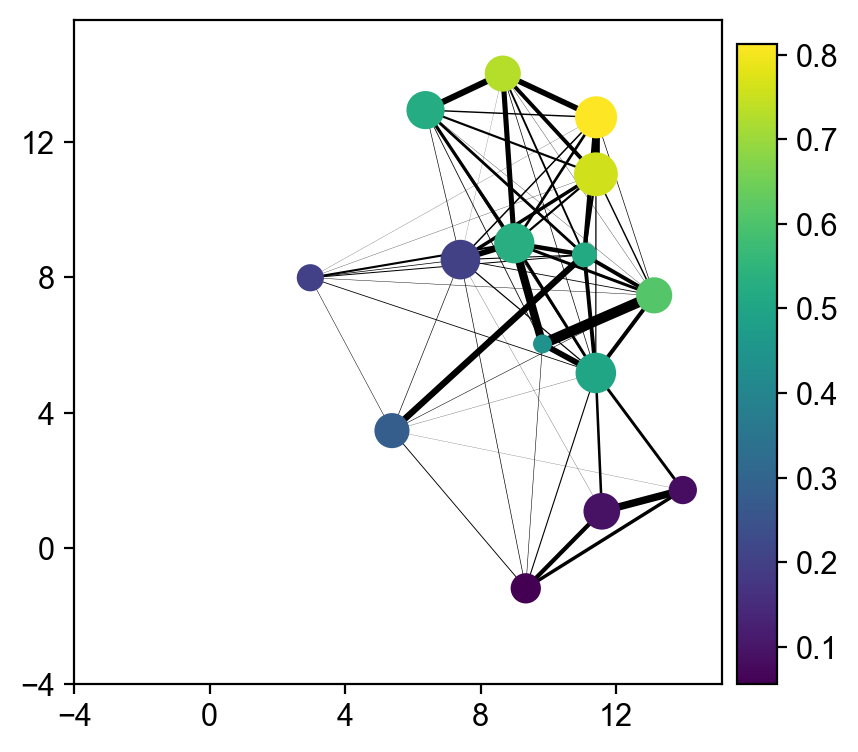

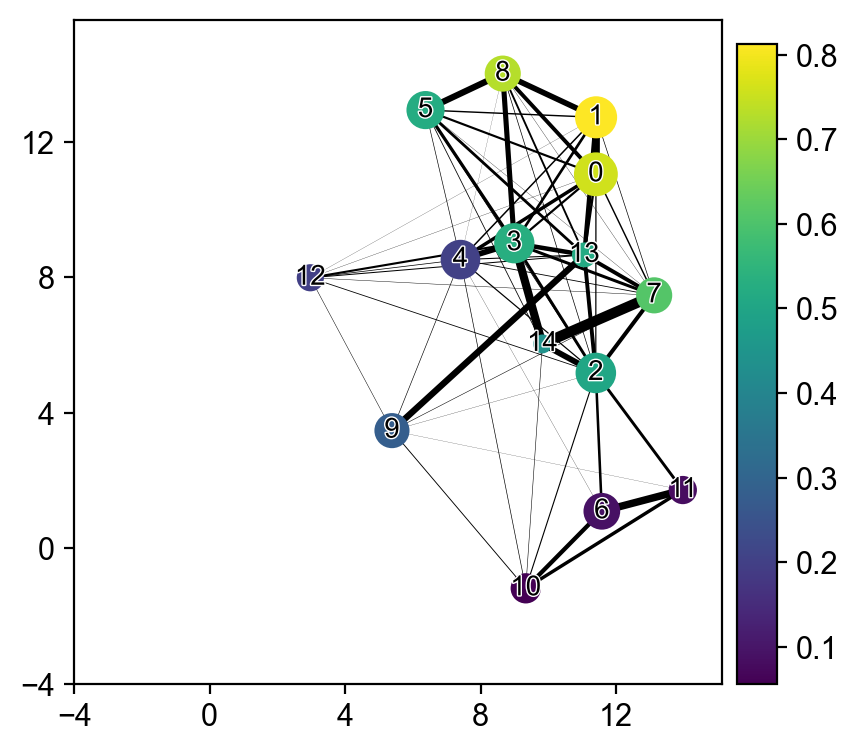

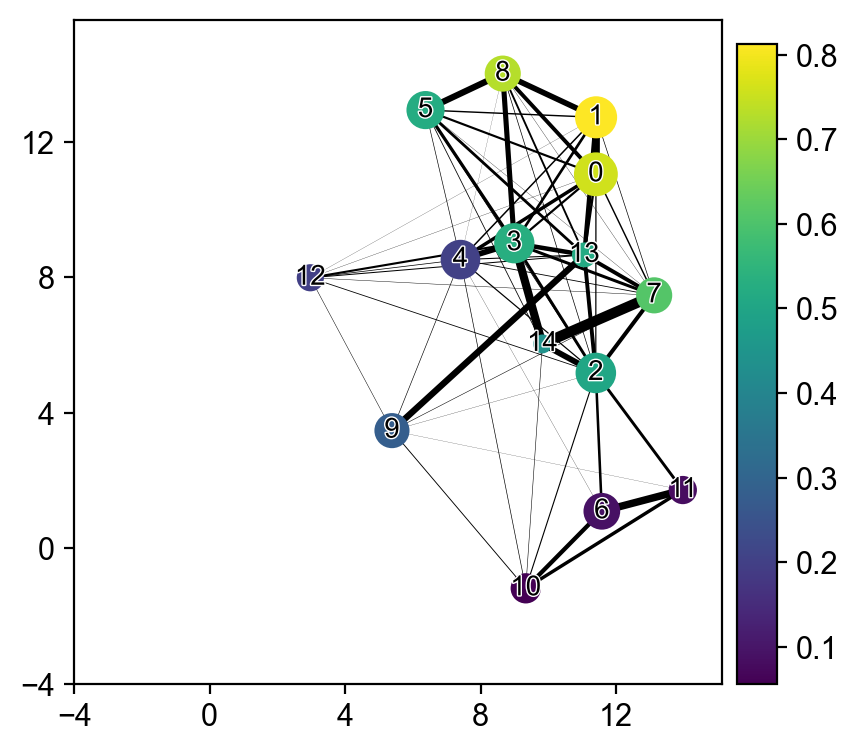

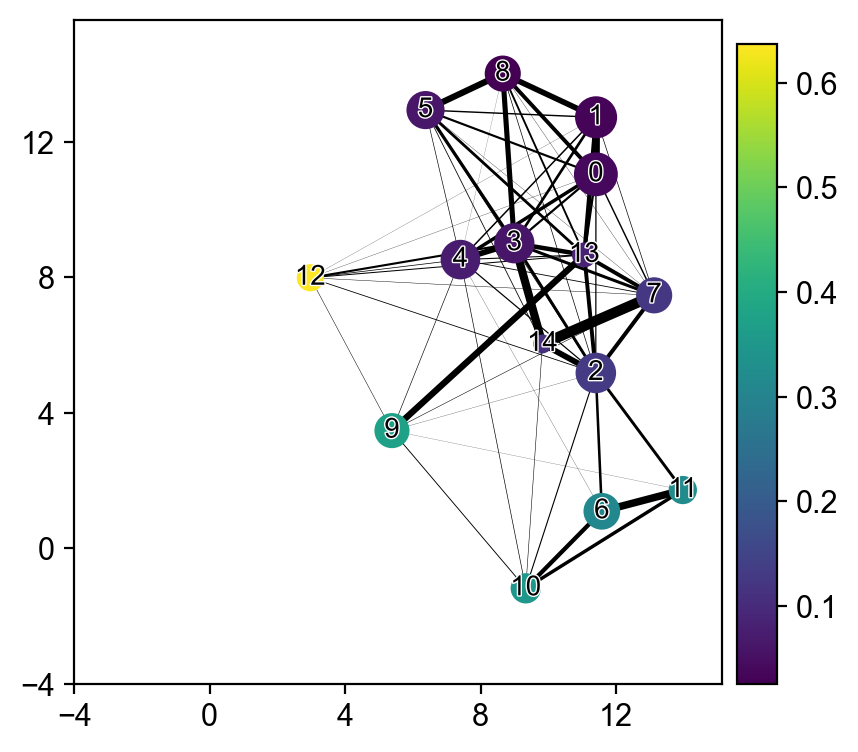

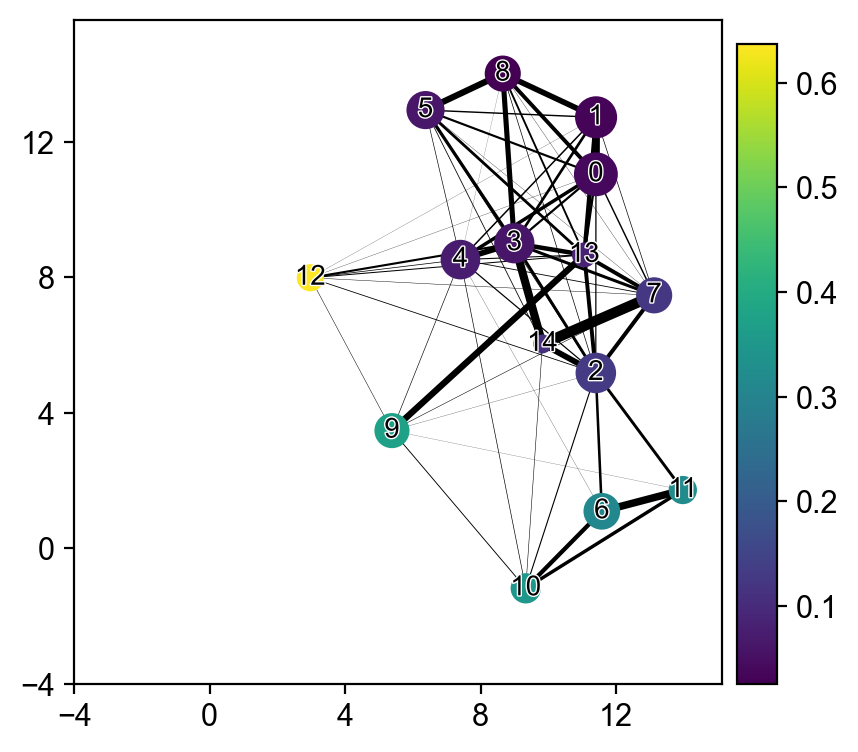

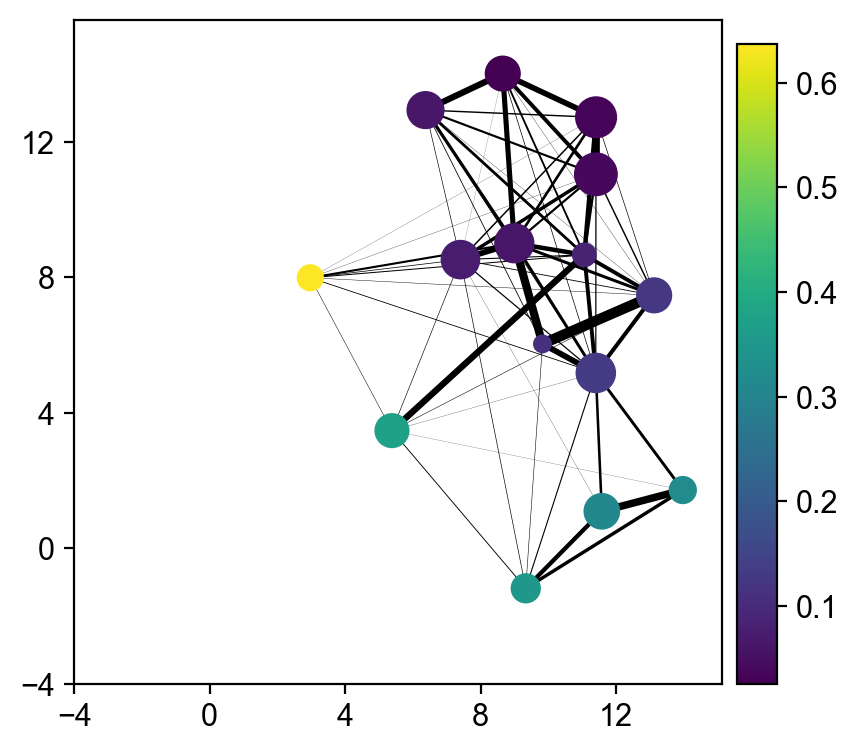

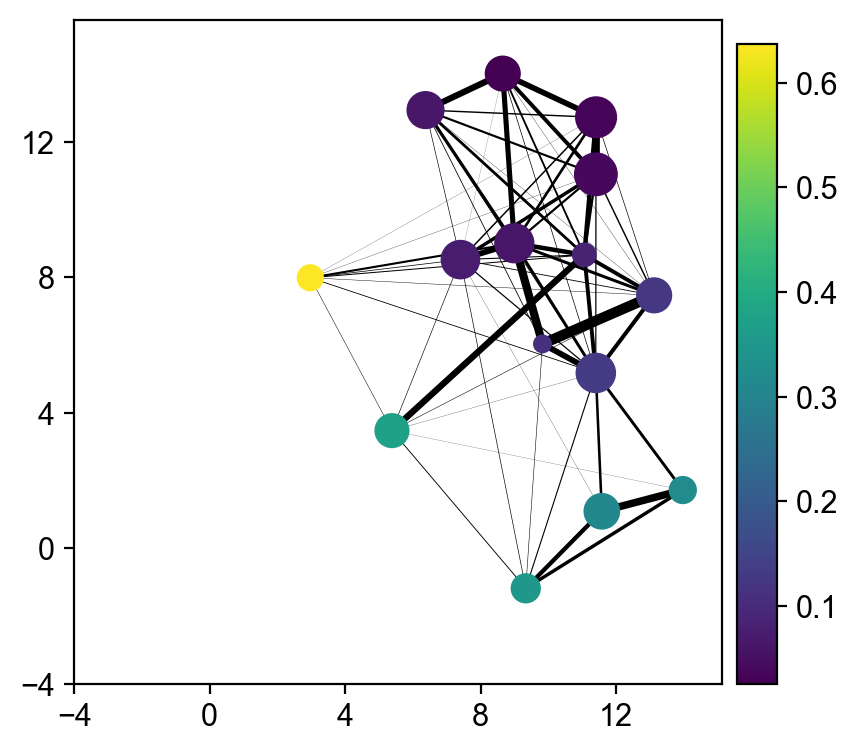

In [ ]:
plot_paga(adata=adata, 
          no_label=True, 
          filename=figure_file_template.format(DIR_NAME, 'Fig4E_paga_cyto_no_label'))
plot_paga(adata=adata,
          no_label=False, 
          filename=figure_file_template.format(DIR_NAME, 'Fig4E_paga_cyto_label'))
plot_paga(adata=adata, 
          no_label=False, 
          color='dpt_pseudotime', 
          filename=figure_file_template.format(DIR_NAME, 'FigS5D_paga_dpt_label'))
plot_paga(adata=adata, 
          no_label=True, 
          color='dpt_pseudotime', 
          filename=figure_file_template.format(DIR_NAME, 'FigS5D_paga_dpt_no_label'))

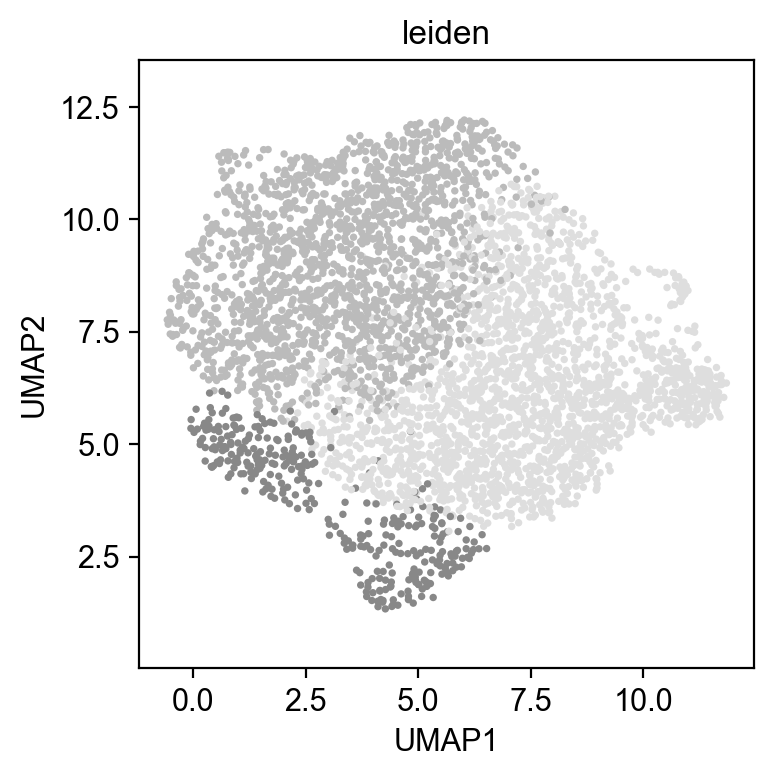

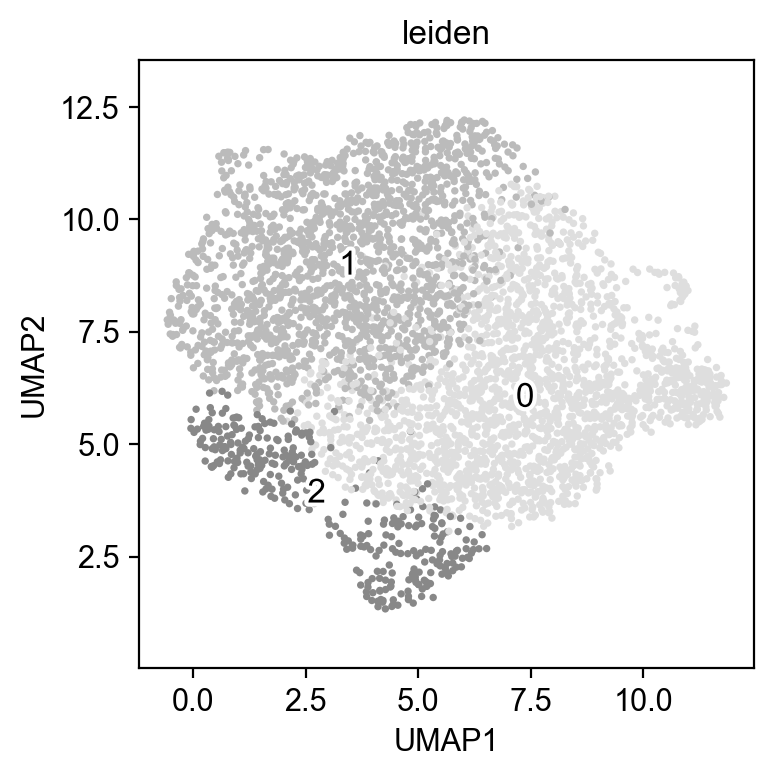

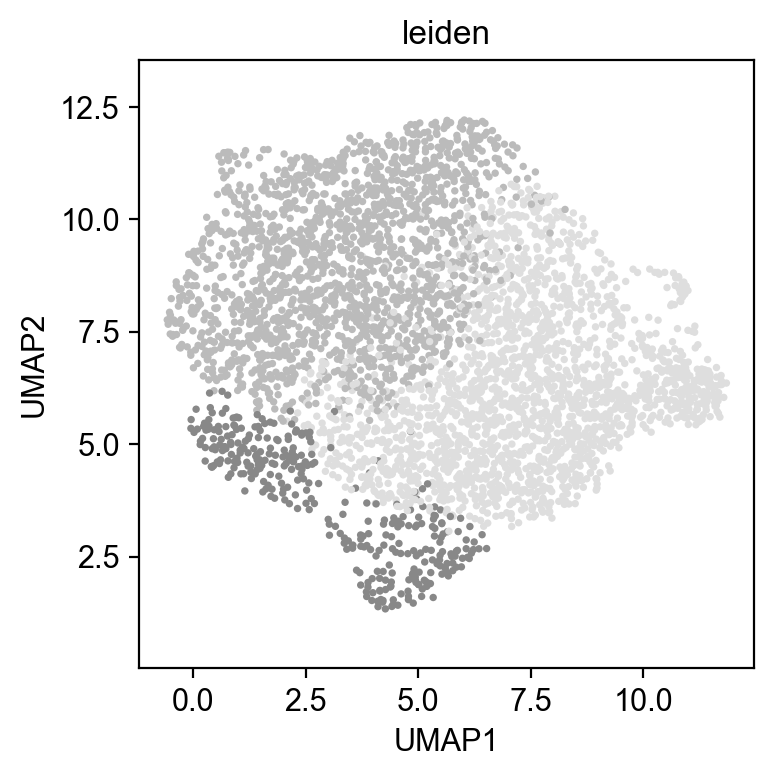

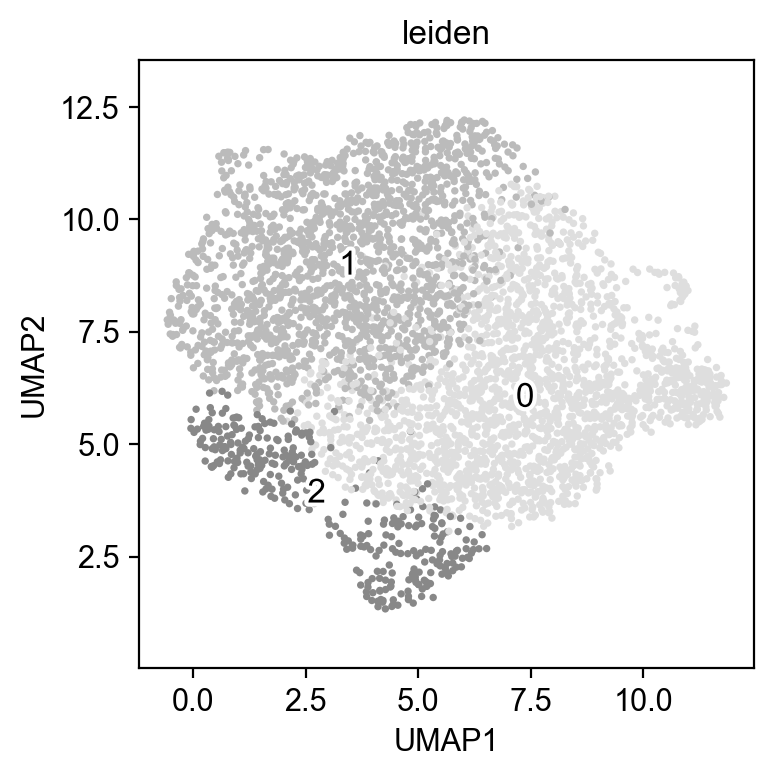

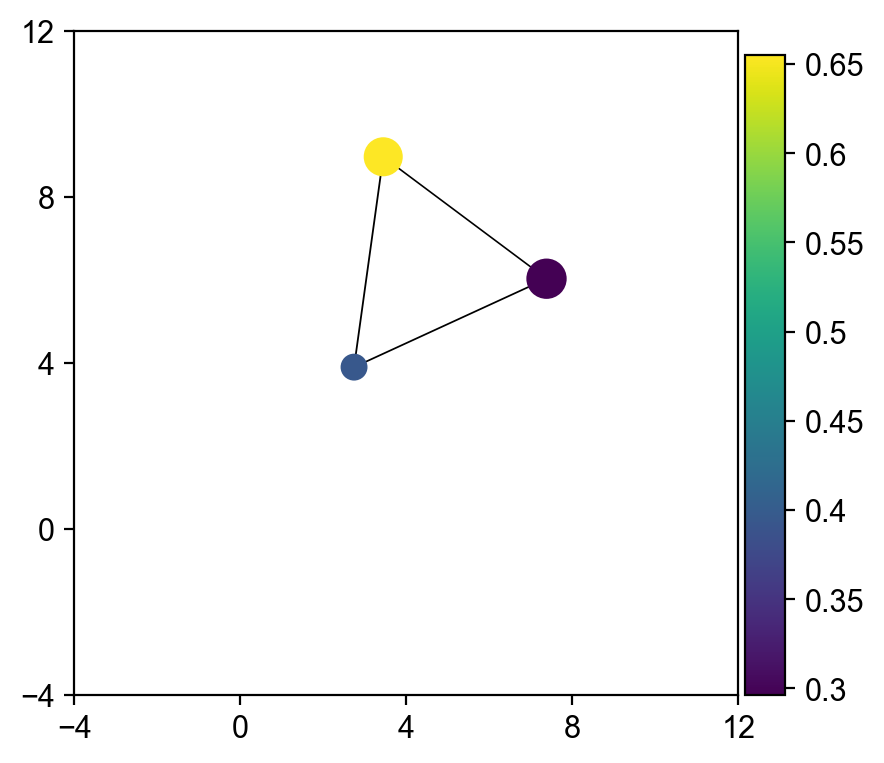

...

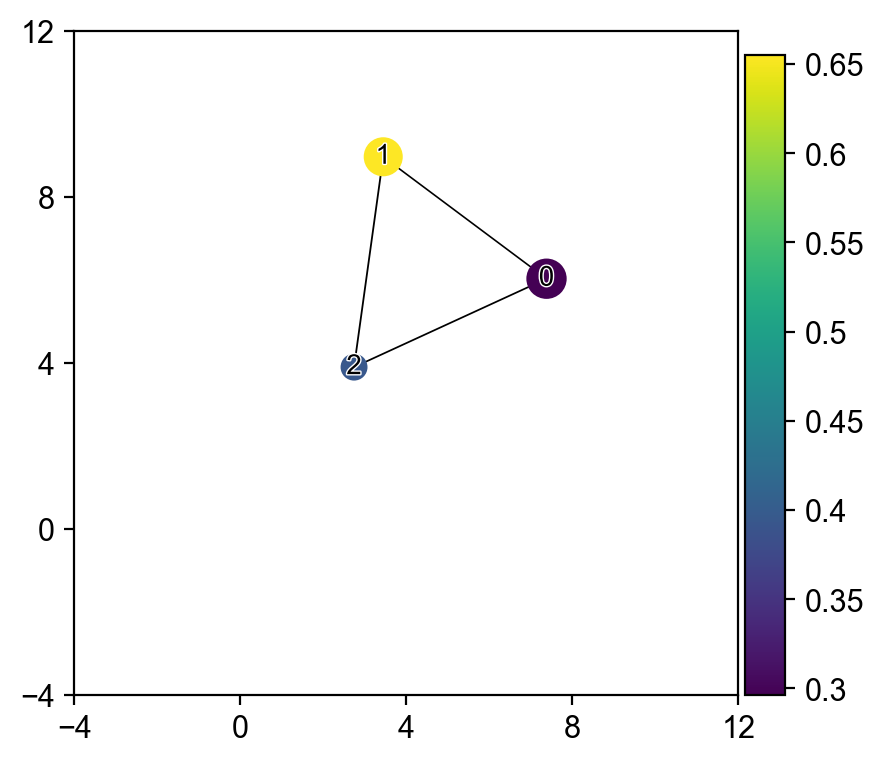

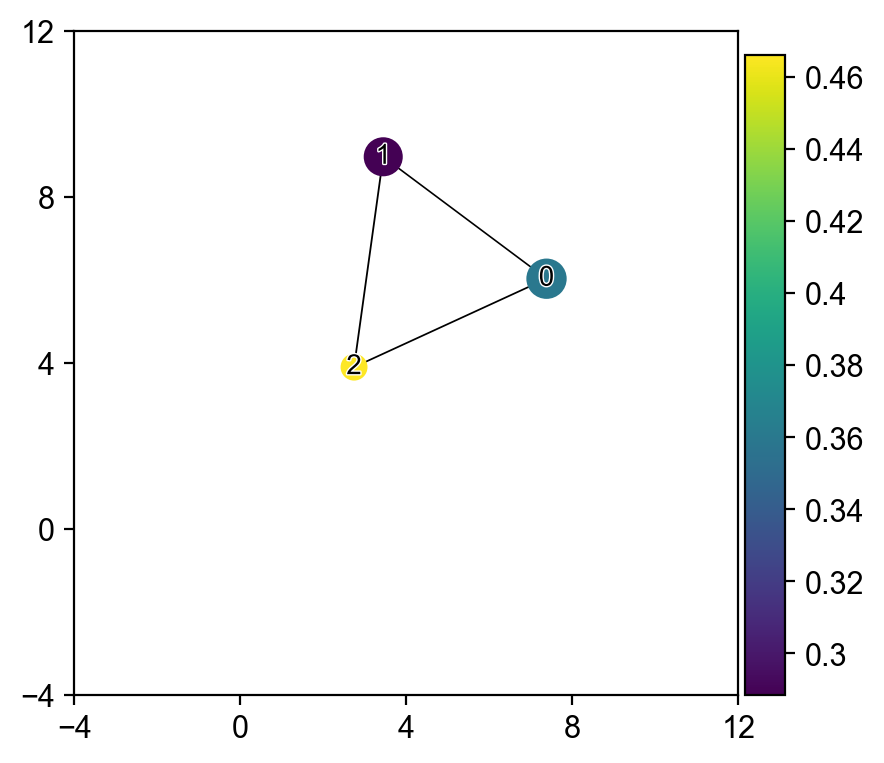

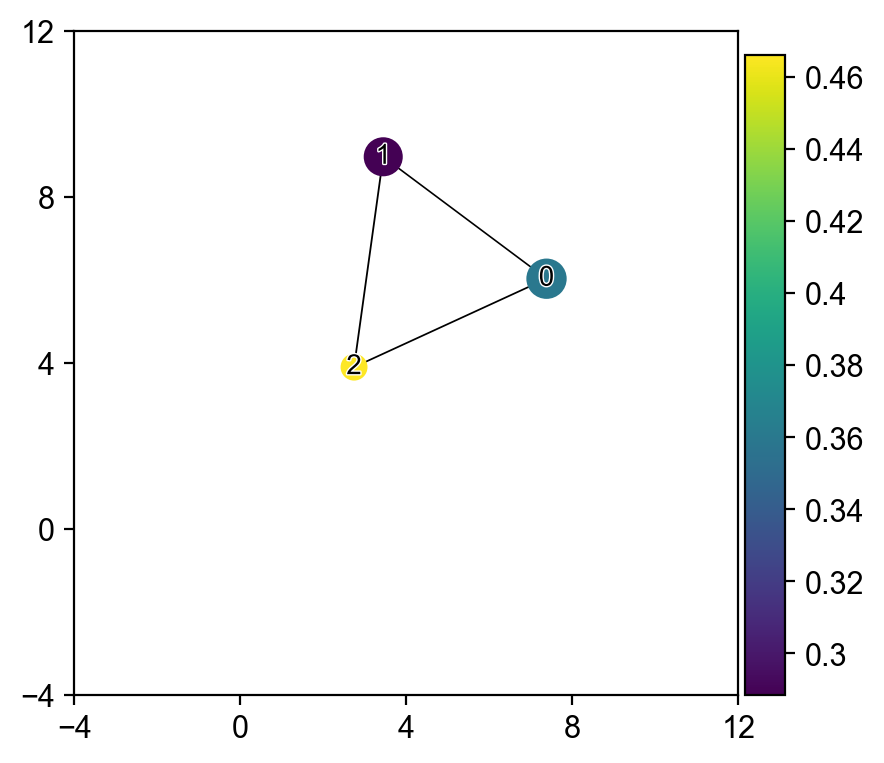

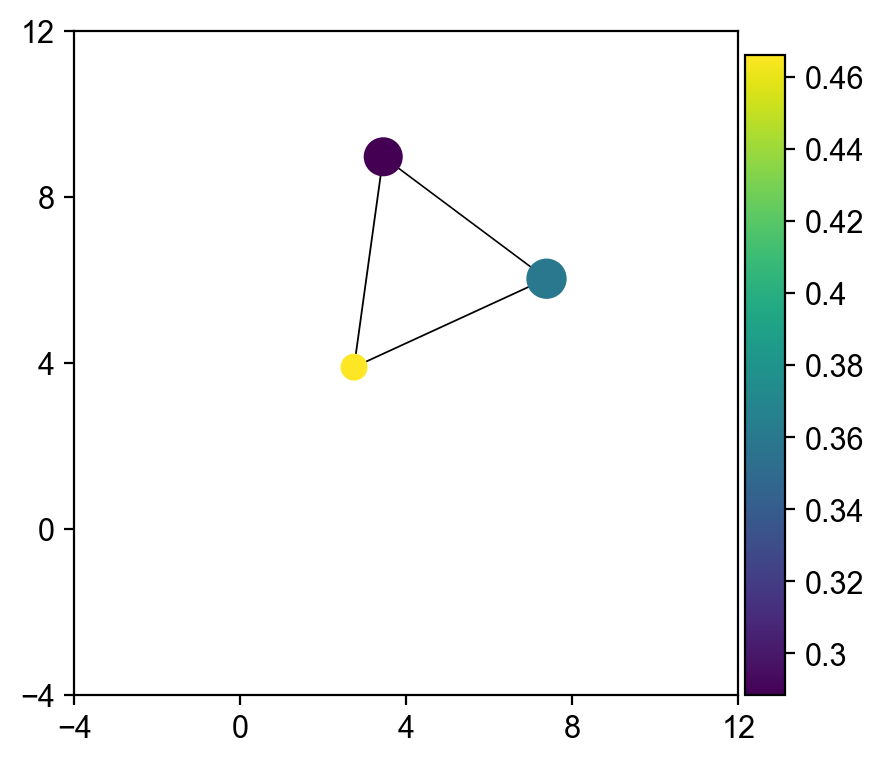

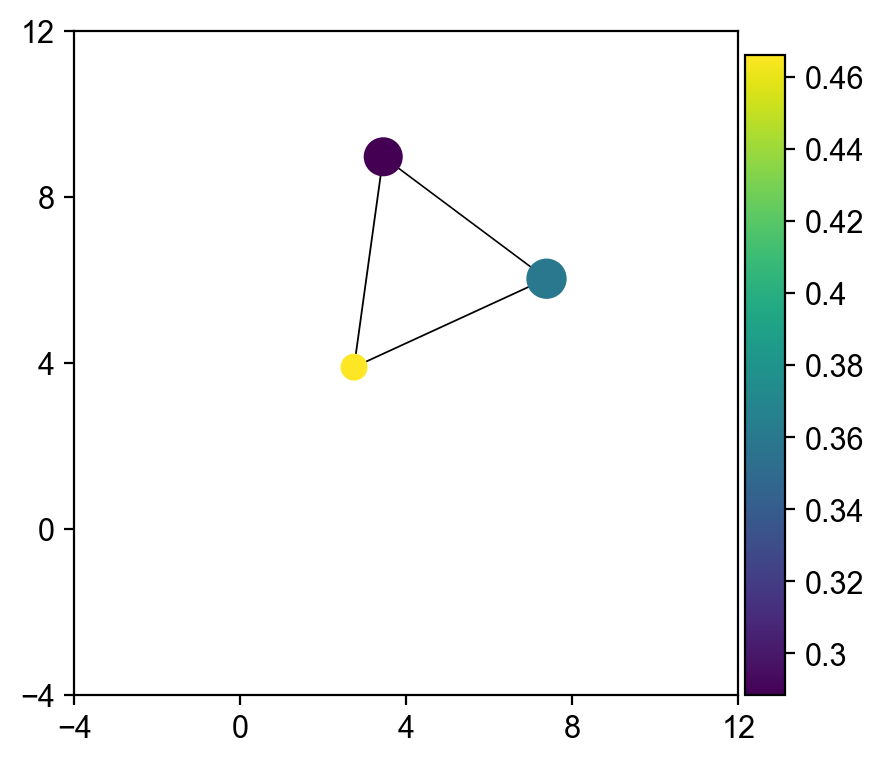

In [ ]:
# For E12.5 re-plot after removing clusters 3 and 4
adata = sc.read_h5ad('../resources/adata_12_frozen.h5ad')

testplots = [sc.pl.umap(adata, color='leiden', legend_loc='None', show=False), # No label
             sc.pl.umap(adata, color='leiden', legend_loc='on data', show=False, legend_fontweight='normal', legend_fontsize=12, legend_fontoutline=3)]
labels = ['no_label', 'with_label']
for i in range(len(labels)):
    label = labels[i]
    plot = testplots[i]
    plot = helper.squarify_umap(plot, adata)
    fig = plot.figure
    dummy = plt.figure()
    new_manager = dummy.canvas.manager
    new_manager.canvas.figure = fig
    fig.set_canvas(new_manager.canvas)
    plt.savefig(figure_file_template.format(DIR_NAME, 'Fig4B_' + label), bbox_inches='tight', dpi=600, facecolor='white')

plot_paga(adata=adata, 
          no_label=True, 
          filename=figure_file_template.format(DIR_NAME, 'Fig4B_paga_cyto_no_label'))
plot_paga(adata=adata,
          no_label=False, 
          filename=figure_file_template.format(DIR_NAME, 'Fig4B_paga_cyto_label'))
plot_paga(adata=adata, 
          no_label=False, 
          color='dpt_pseudotime', 
          filename=figure_file_template.format(DIR_NAME, 'FigS5B_paga_dpt_label'))
plot_paga(adata=adata, 
          no_label=True, 
          color='dpt_pseudotime', 
          filename=figure_file_template.format(DIR_NAME, 'FigS5B_paga_dpt_no_label'))

In [2]:
# Plot multiple UMAPs for genes and pathways
times = ['E12.5', 'E15.5', 'E17.5']
adata_files = ['../resources/adata_12_frozen.h5ad',
               '../resources/adata_15_frozen.h5ad',
               '../resources/adata_17_frozen.h5ad']
adatas = []
for adata_file in adata_files:
    adata = sc.read_h5ad(adata_file)
    print('{}: \n{}'.format(adata_file, adata))
    adatas.append(adata)

../resources/adata_12_frozen.h5ad: 
AnnData object with n_obs × n_vars = 4210 × 17800
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'CytoTRACE', 'leiden', 'dpt_pseudotime'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'diffmap_evals', 'hvg', 'iroot', 'leiden', 'leiden_colors', 'leiden_sizes', 'neighbors', 'paga', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_aucell', 'X_diffmap', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts'
    obsp: 'connectivities', 'distances'
../resources/adata_15_frozen.h5ad: 
AnnData object with n_obs × n_vars = 6513 × 19513
    obs: 'scrublet_doublet_score', 'scrublet_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_c

In [3]:
def plot_multi_umaps(features: list,
                     figure_name: str,
                     times = times,
                     adatas = adatas):
    feature2max = {}
    for feature in features:
        gene_exp_list = [adata.obs_vector(feature).max() for adata in adatas if (feature in adata.var_names) or (feature in adata.obs_keys())]
        feature2max[feature] = max(gene_exp_list)

    for feature in features:
        for i in range(len(times)):
            time = times[i]
            adata = adatas[i]
            if (feature not in adata.var_names) and (feature not in adata.obs_keys()): # Defa24's case
                adata.obs[feature] = [0] * adata.shape[0]
            plot = sc.pl.umap(adata, color=feature, cmap='viridis_r', vmax=feature2max[feature], show=False)
            helper.squarify_umap(plot, adata)
            # cbar = plot.figure.properties()['default_bbox_extra_artists'][1]
            # cbar.set_position((0.85,0.70,0.5,0.5)) # Manually determined: left, bottom, width, and height.
            ax = plt.gca()
            ax.spines['right'].set_visible(False)
            ax.spines['top'].set_visible(False)
            file_name = figure_file_template.format(DIR_NAME, figure_name + '_' + feature + "_" + time)
            plt.savefig(file_name, bbox_inches='tight', dpi=600, facecolor='white')
        # break

['Fzd1', 'Fzd2', 'Fzd3', 'Fzd4', 'Fzd5', 'Fzd6', 'Fzd7', 'Fzd8', 'Lrp5', 'Lrp6']


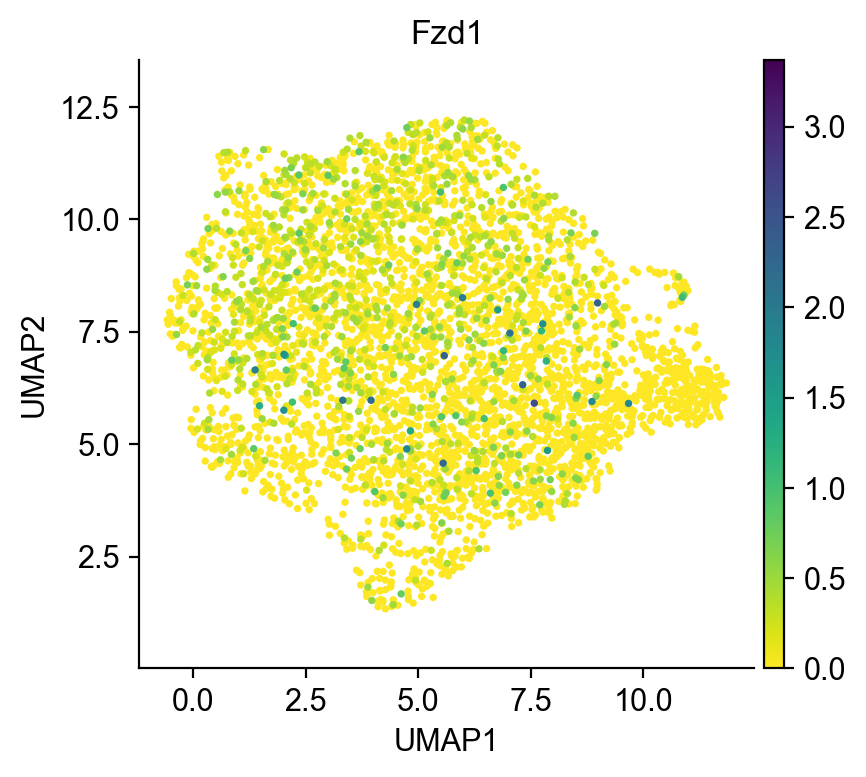

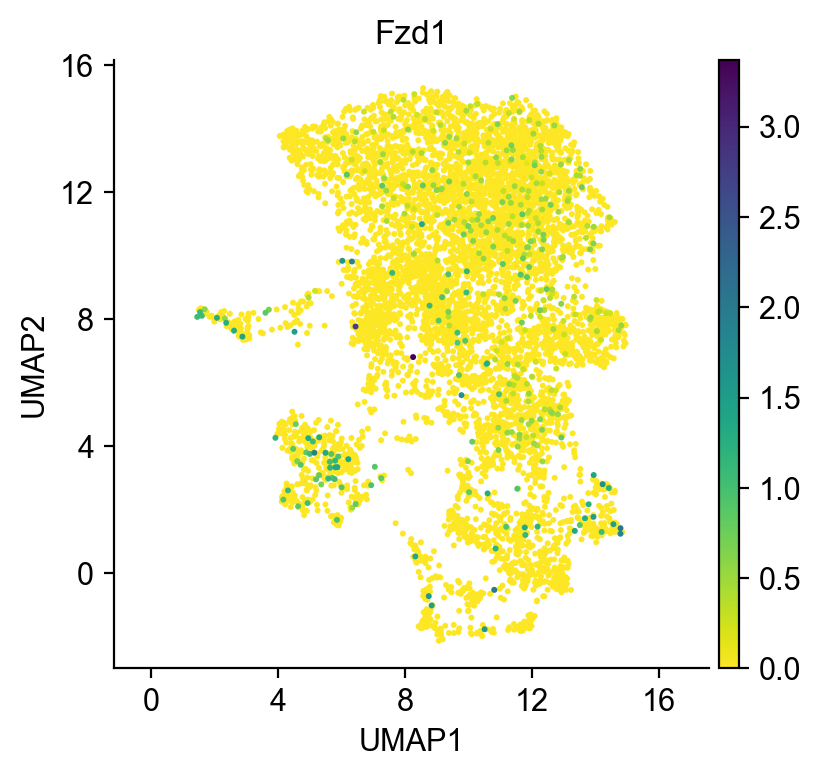

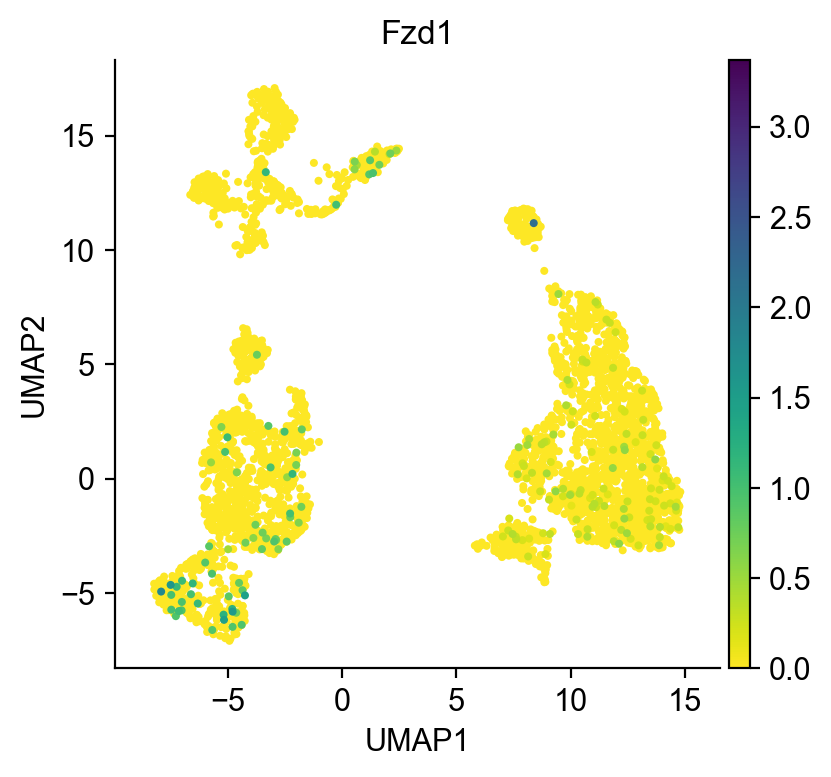

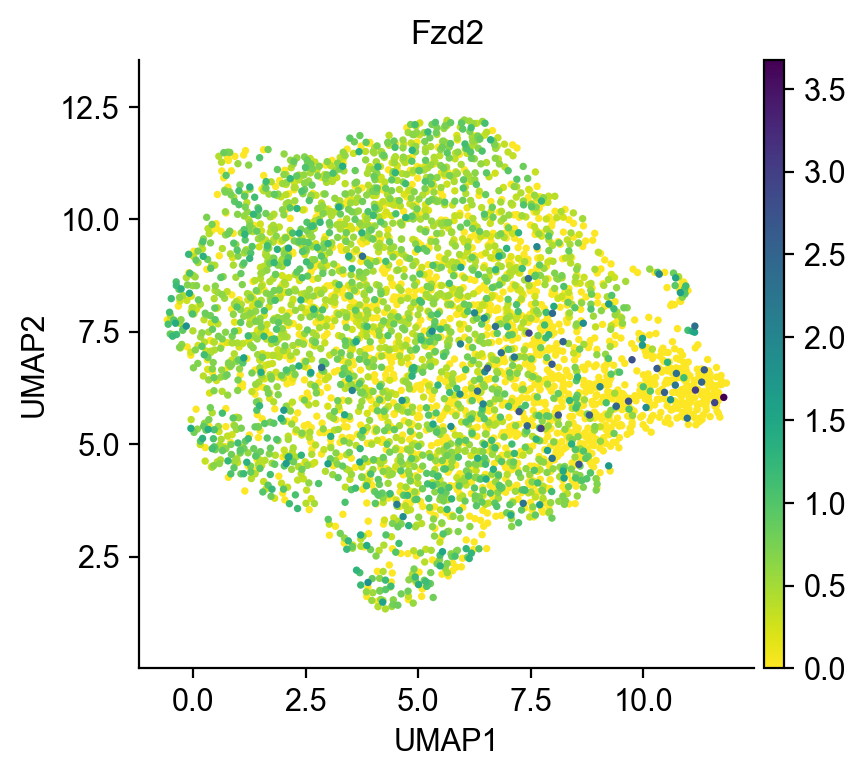

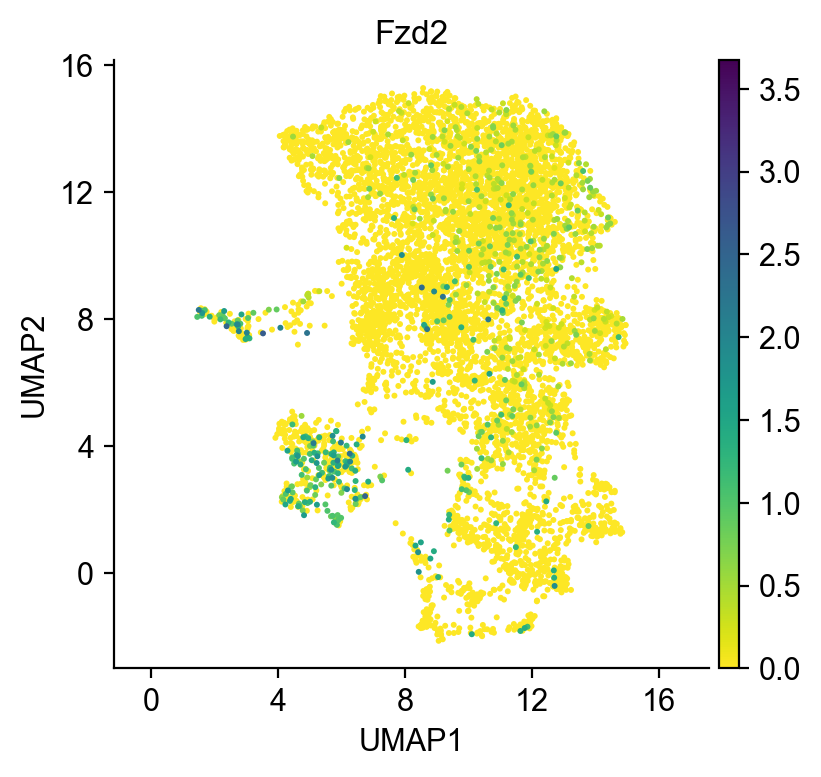

...

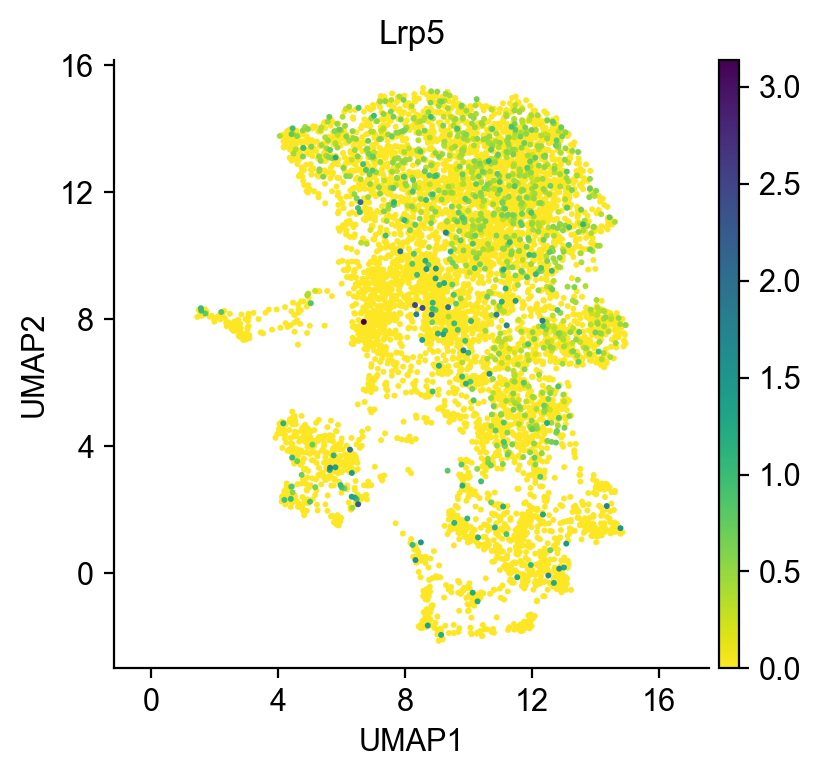

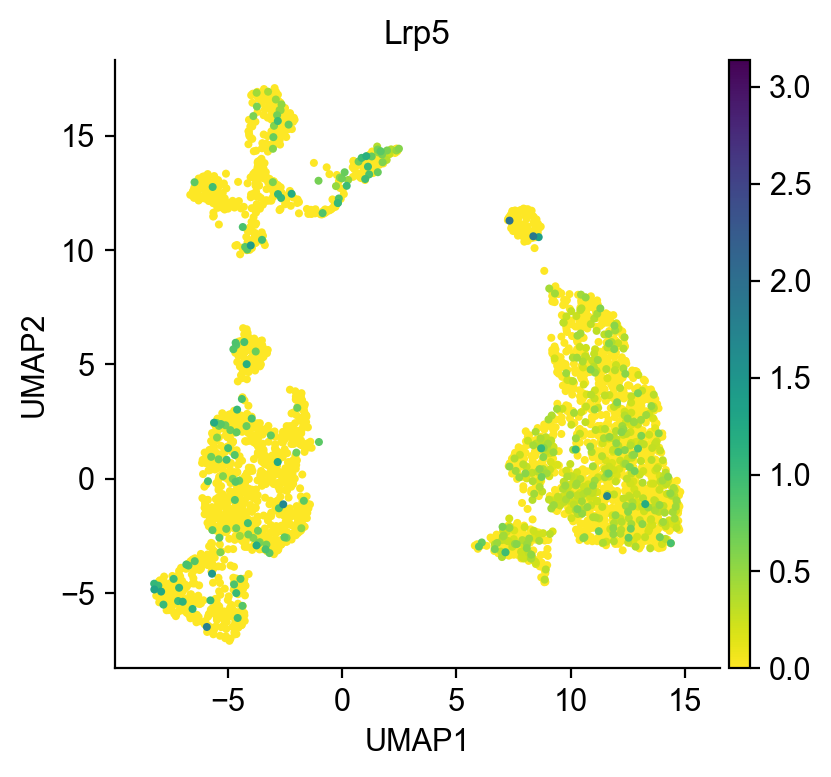

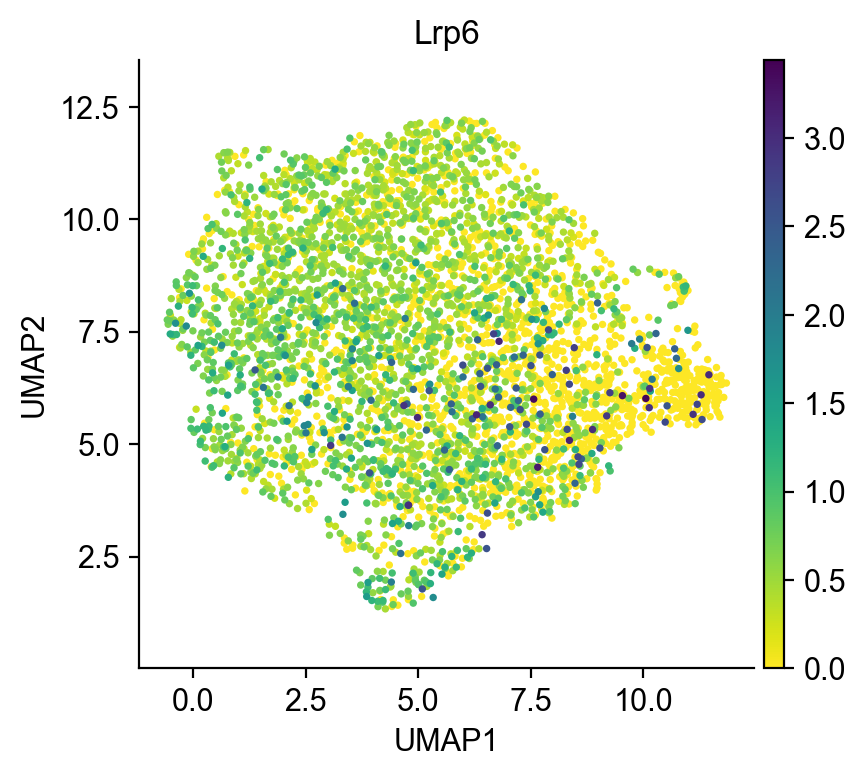

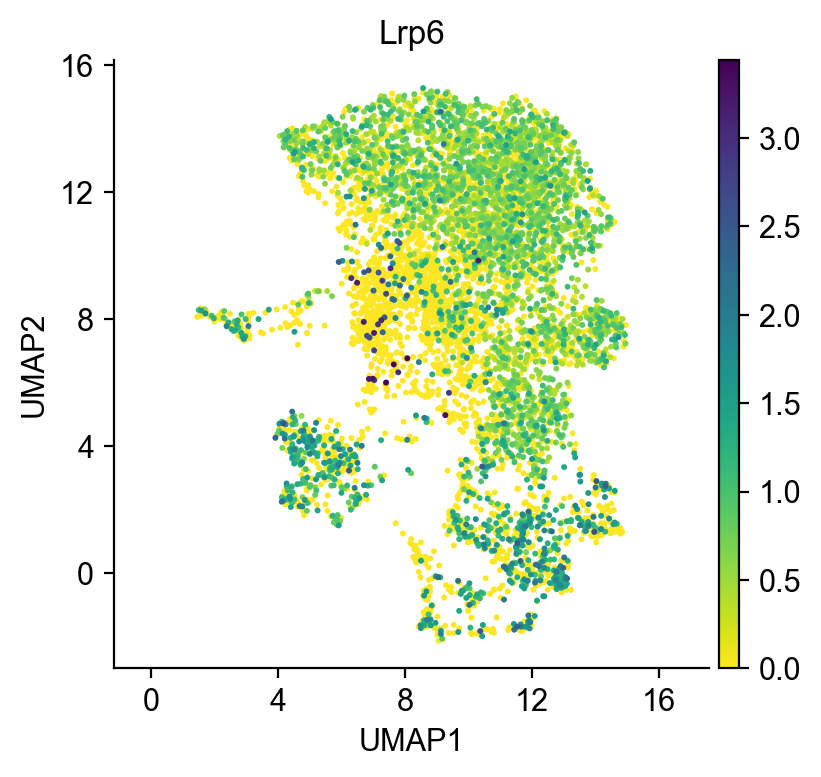

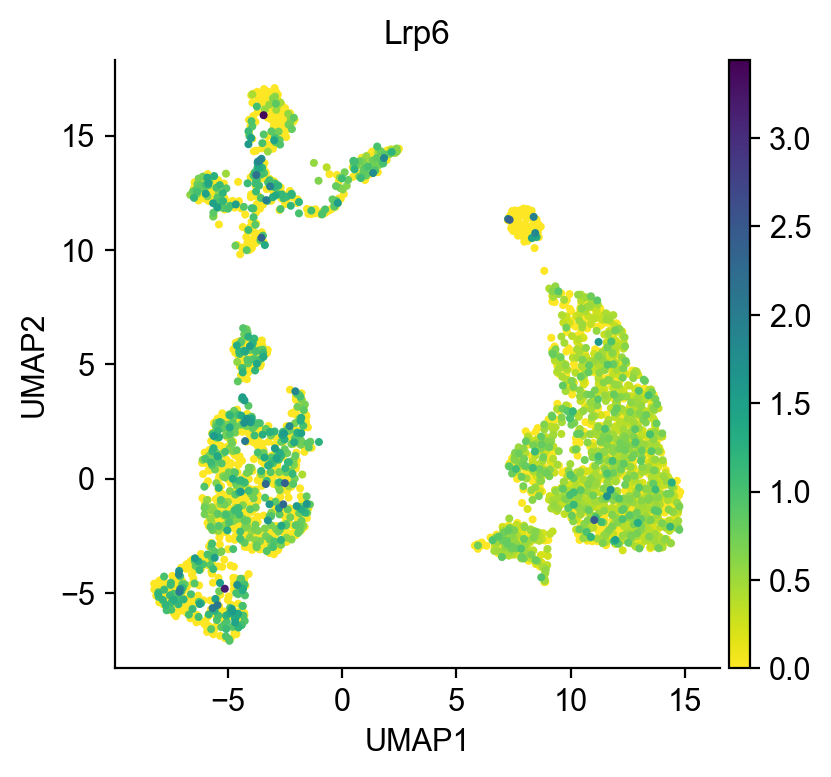

In [6]:
# Fig 5F E15.5 for gene expression
# The following code copied from figures.py for easy visualization
# Neeed all three adata to set the same color scales for comparison
# genes = ['Pou5f1', 'Alpi', 'Defa24', 'Chga', 'Wnt3', 'Wnt5a', 'Sfrp5', 'Dkk3']
genes = ['Fzd{}'.format(i) for i in range(1, 9)]
genes.extend(['Lrp5', 'Lrp6'])
print(genes)
plot_multi_umaps(genes, 'Fig5F')

In [ ]:
# To plot pathways, we need to make sure pathways activities are there
def ensure_pathway(pathways, adatas=adata):
    for adata in adatas:
        pathway_df = adata.obsm[pa.AUCELL_KEY] # This is a dataframe with pathway names as columns
        for pathway in pathways:
            if pathway in pathway_df.columns:
                adata.obs[pathway] = pathway_df[pathway]
            else:
                adata.obs[pathway] = 0

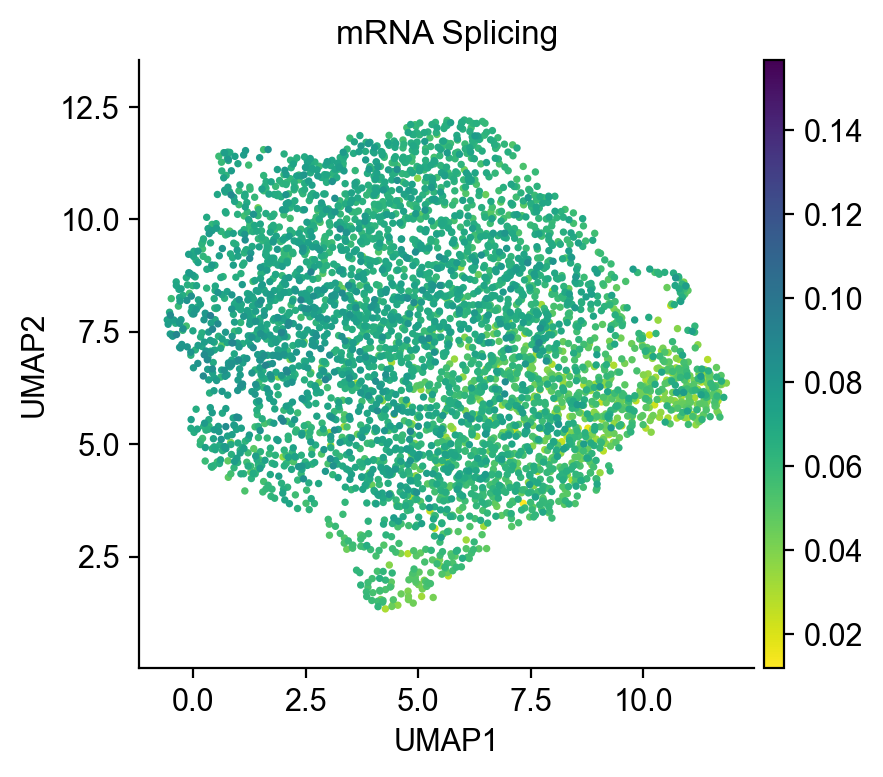

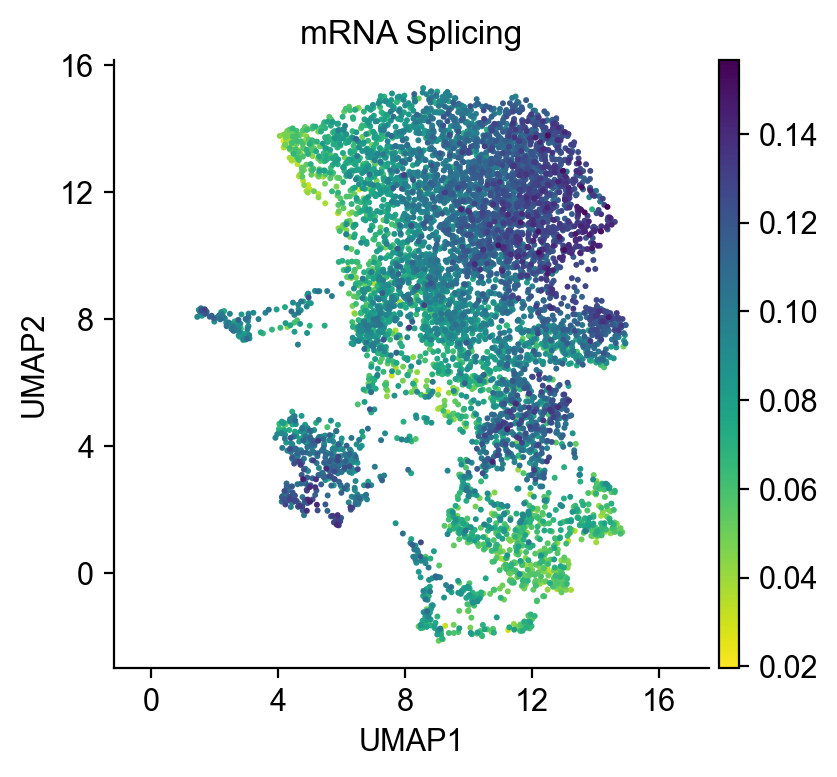

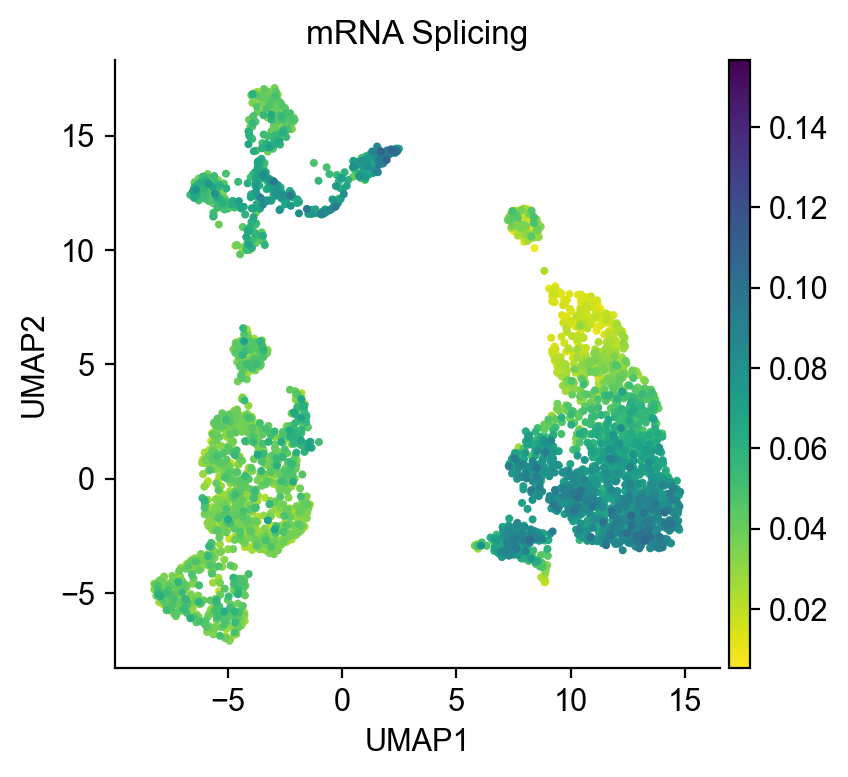

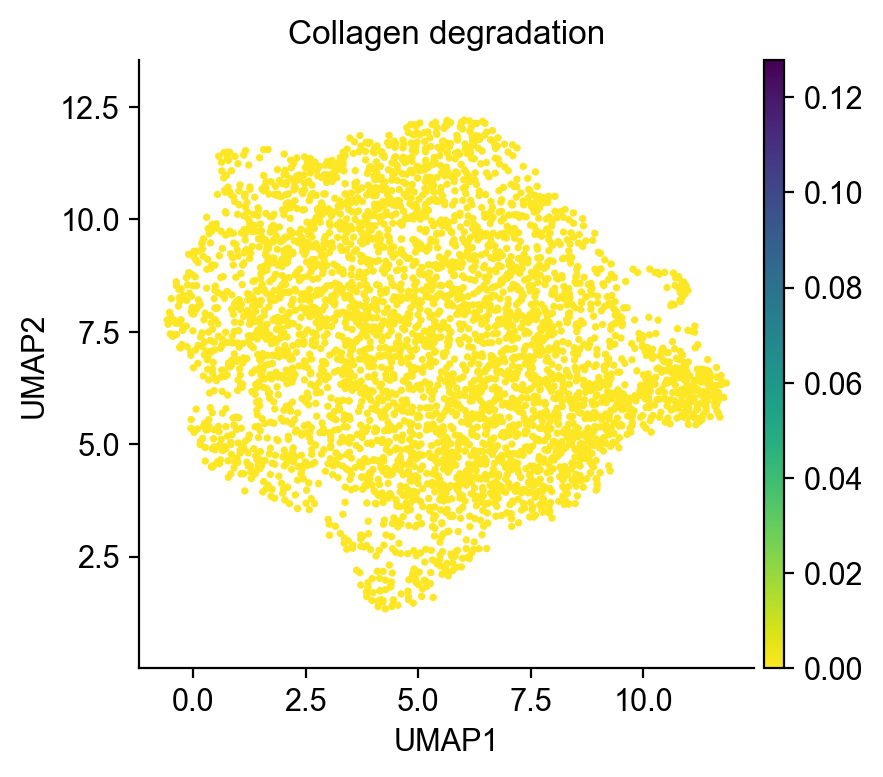

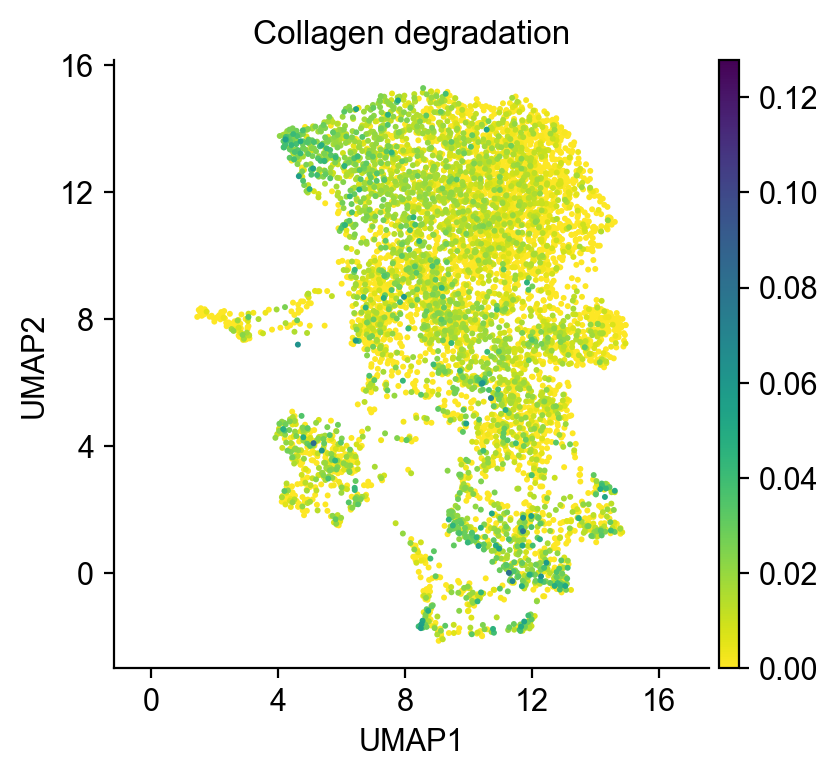

...

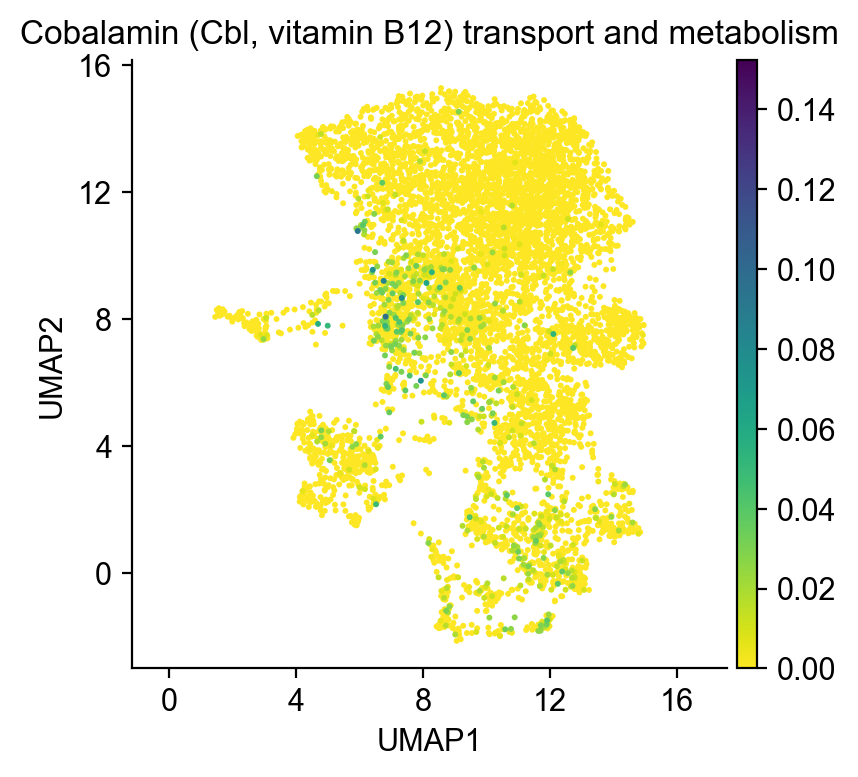

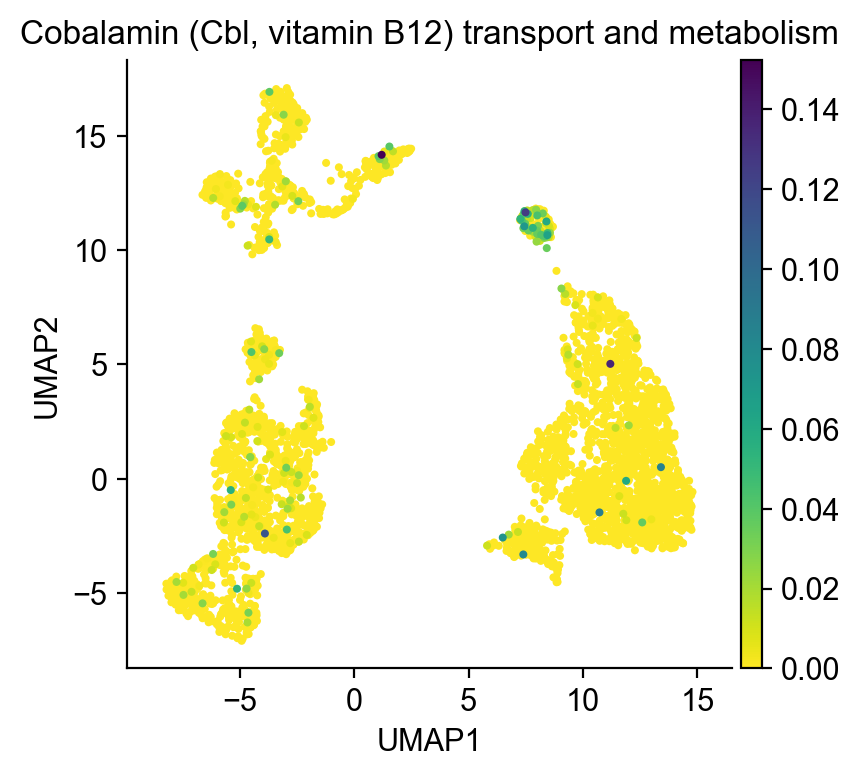

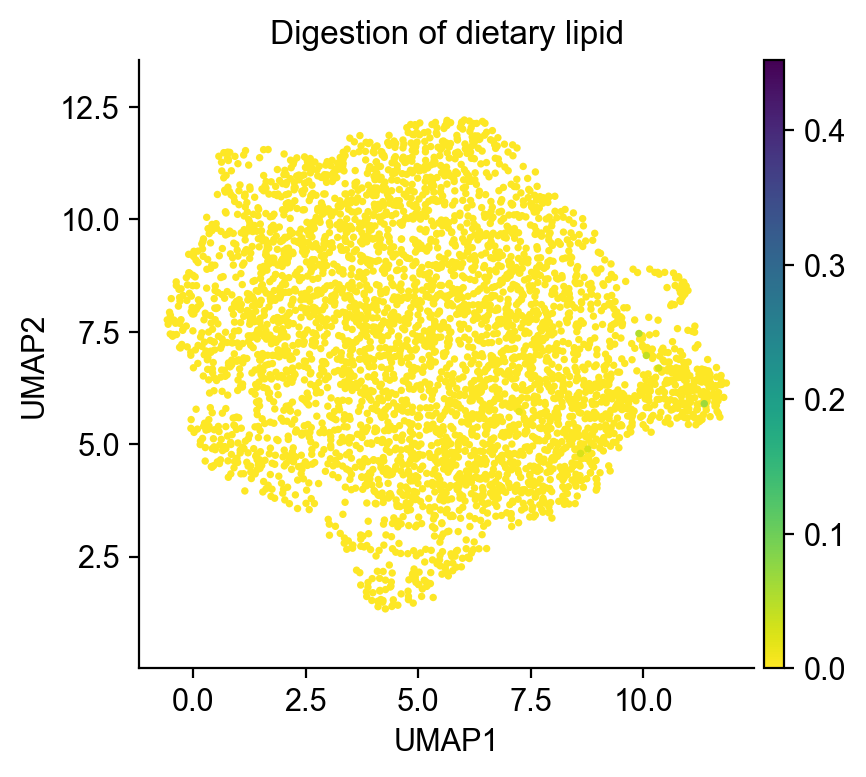

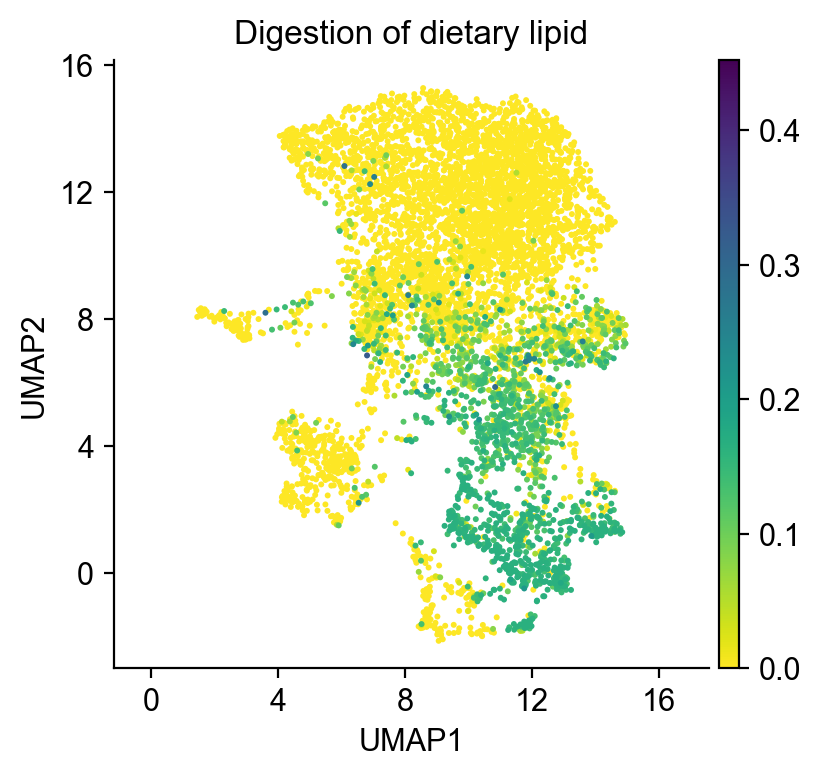

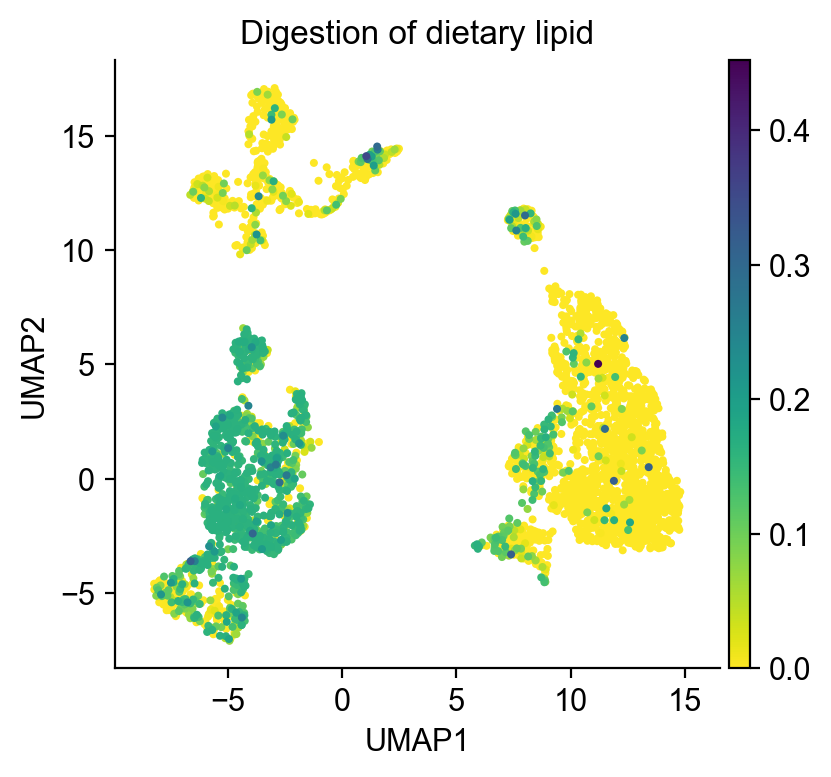

In [ ]:
# Pathway Activity Plot
# The following pathways are for Fig 5G
fig5g_pathways = [
    'mRNA Splicing', 
    'Collagen degradation', 
    'Cobalamin (Cbl, vitamin B12) transport and metabolism', 
    'Digestion of dietary lipid']
ensure_pathway(fig5g_pathways, adatas)
plot_multi_umaps(fig5g_pathways, 'Fig5G')

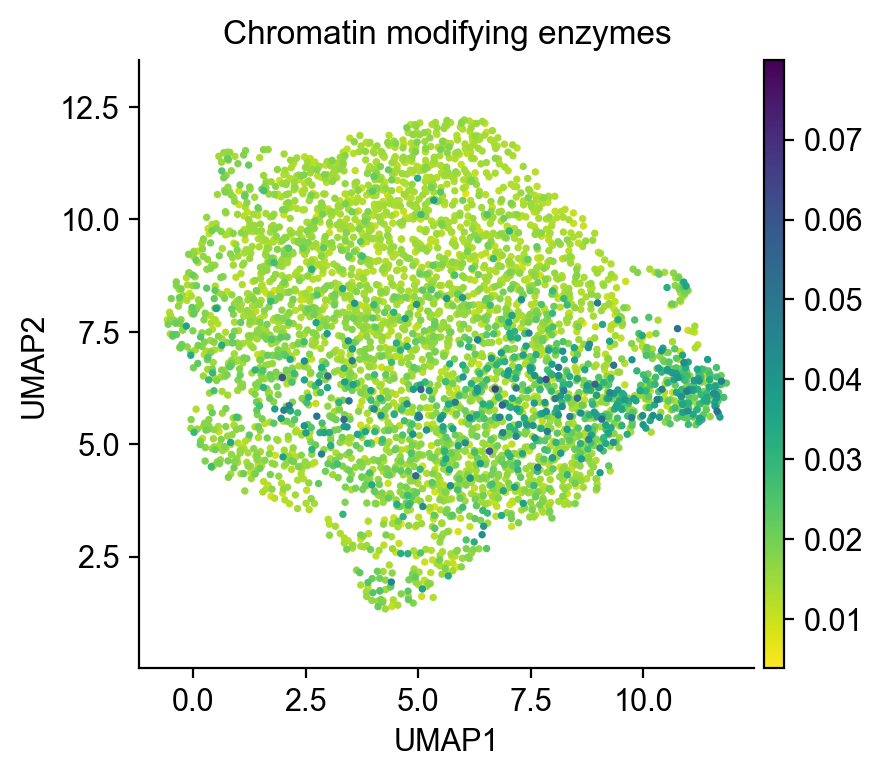

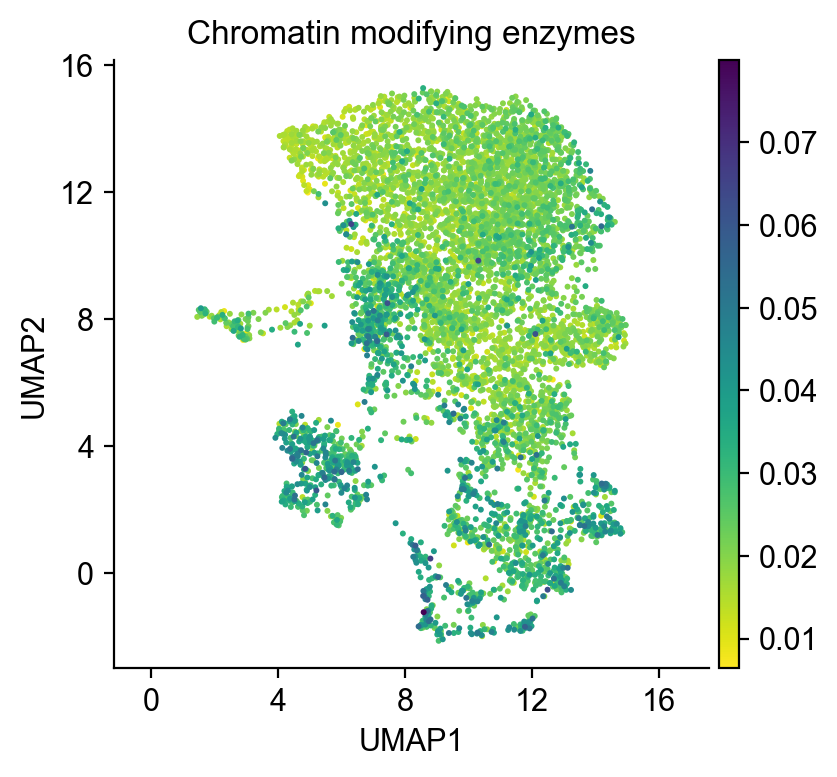

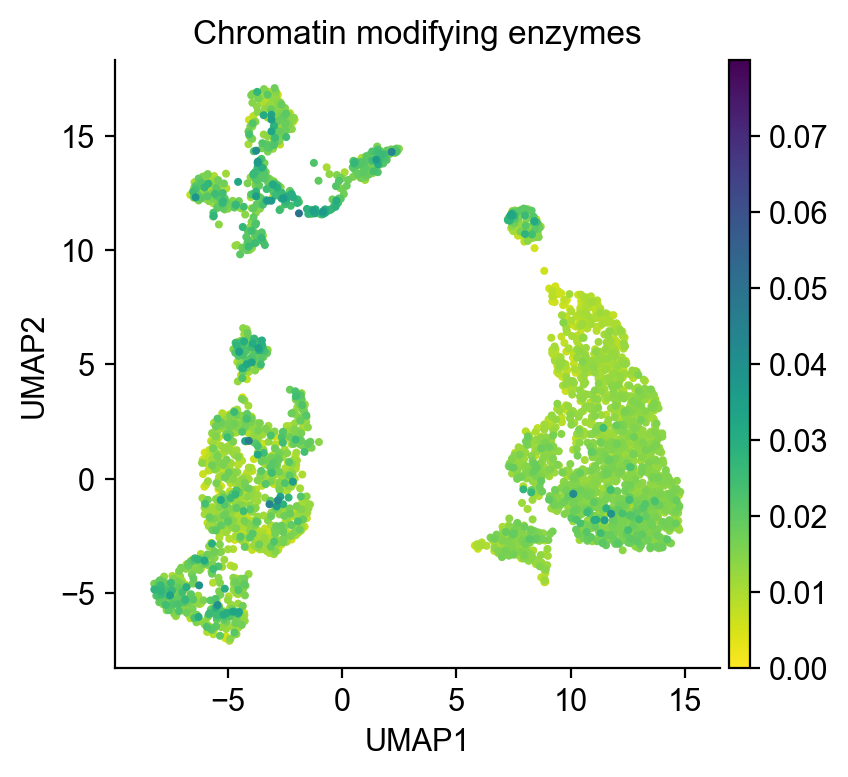

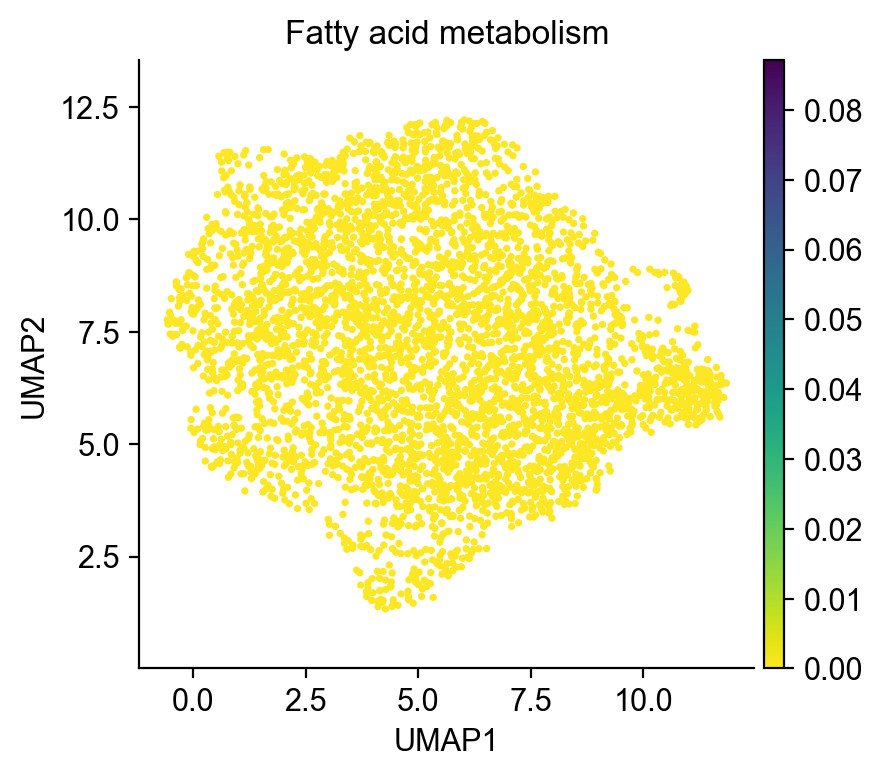

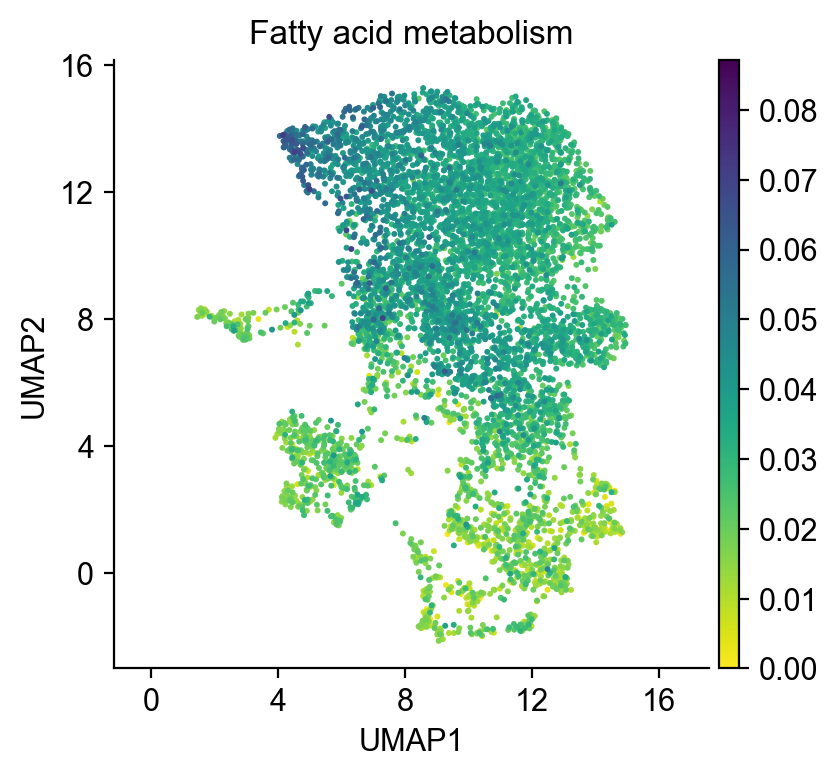

...

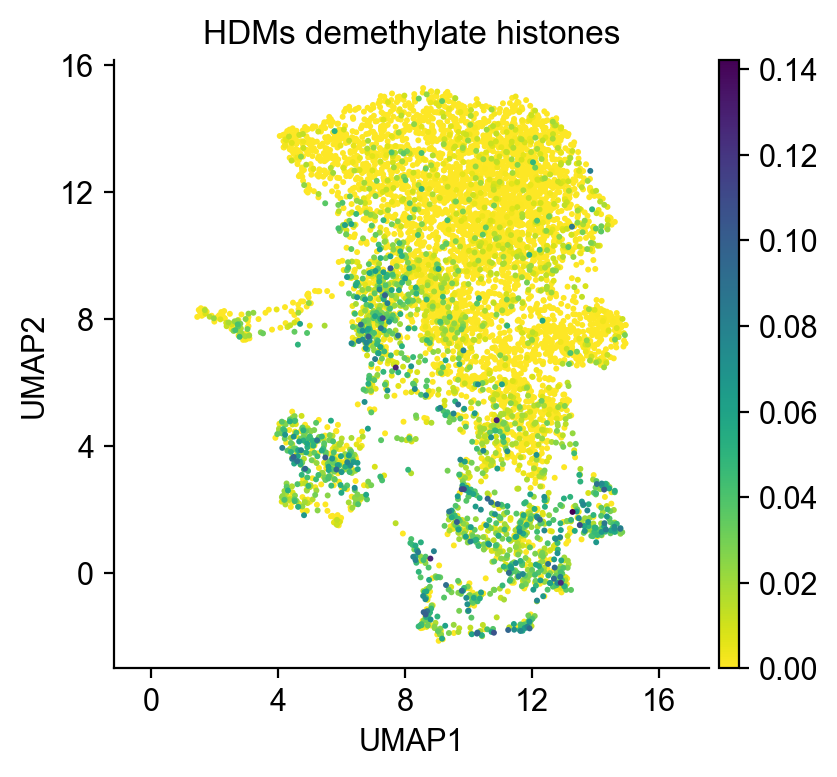

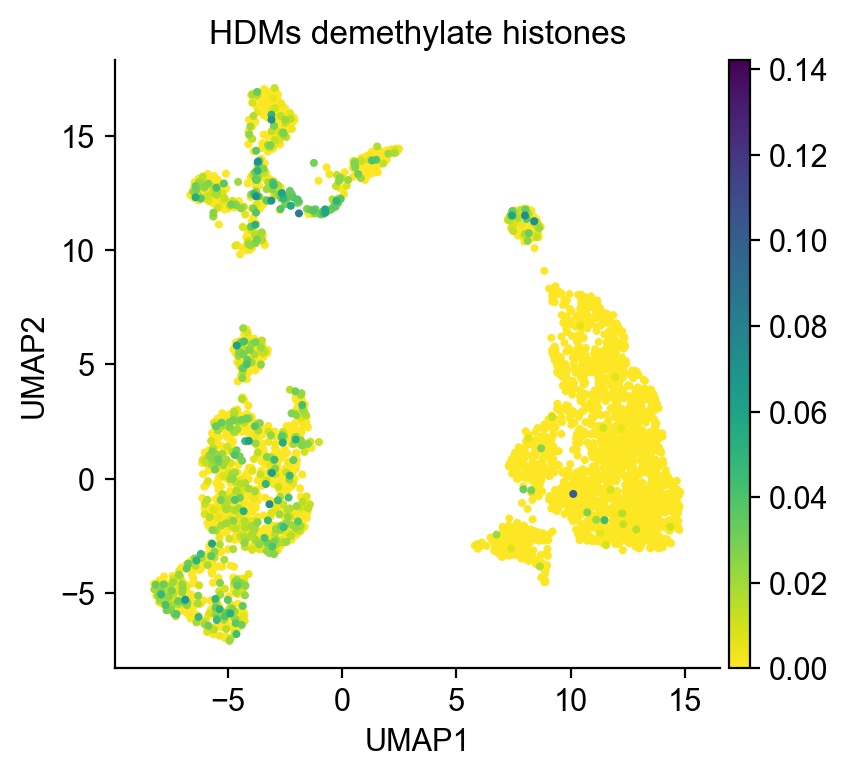

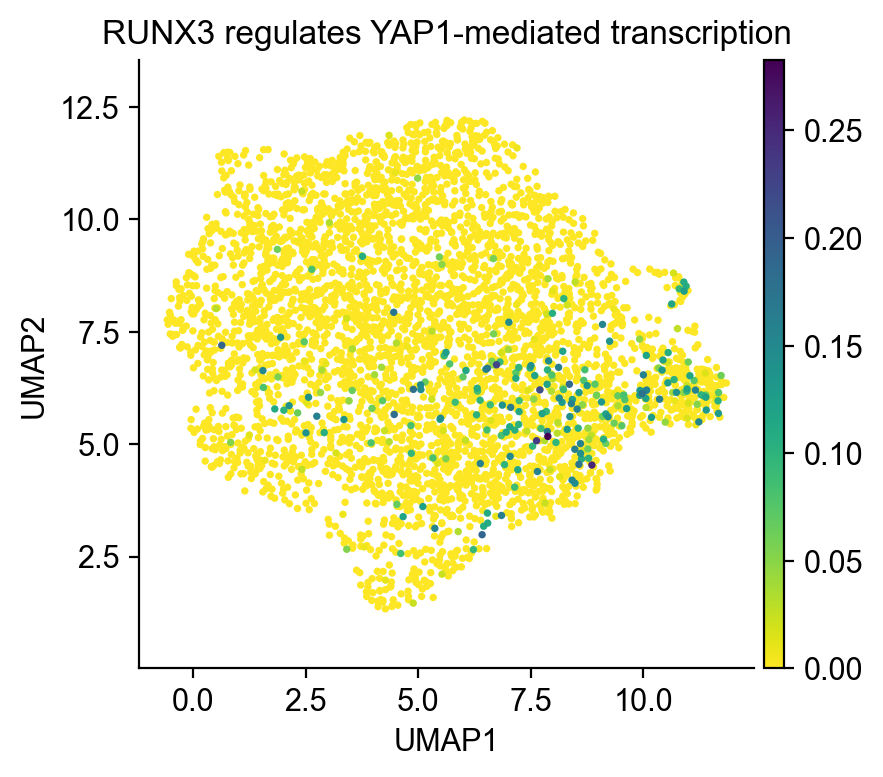

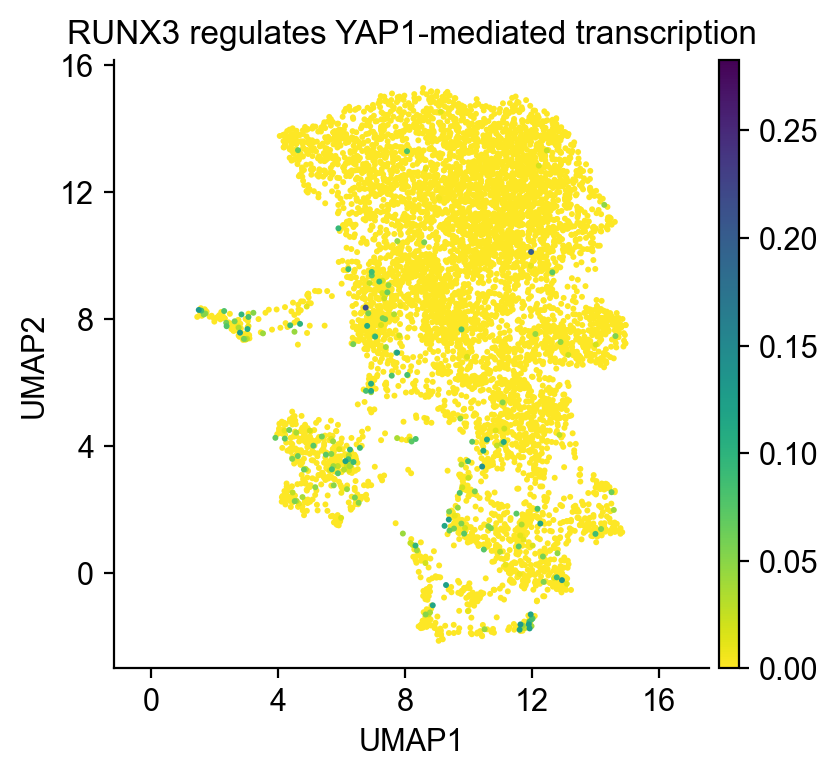

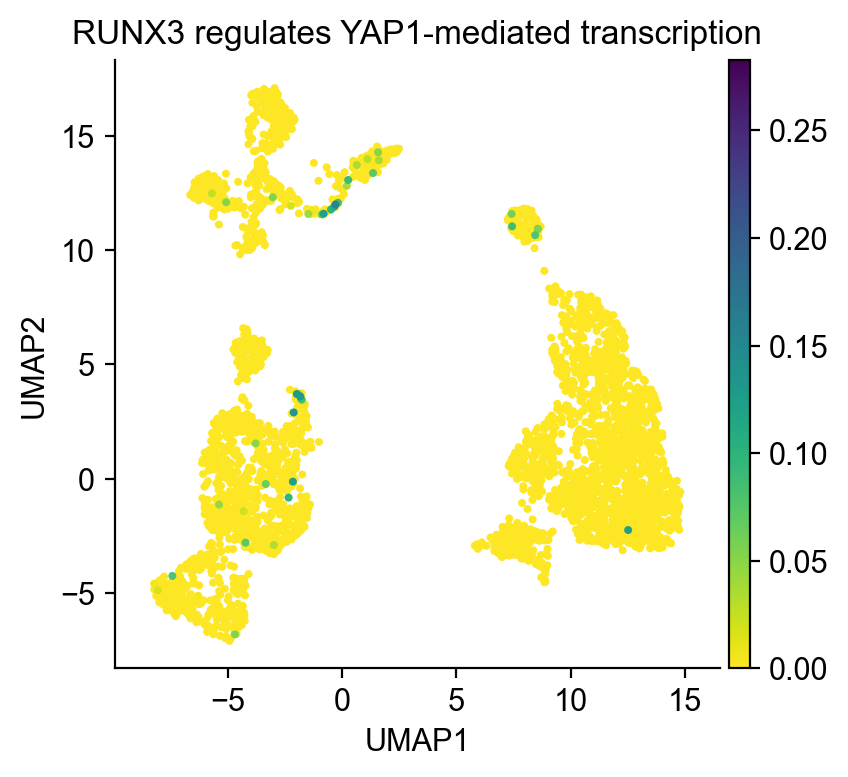

In [ ]:
# The following pathways are for Fig S5
figS5_pathways = [
    'Chromatin modifying enzymes',
    'Fatty acid metabolism', 
    'Growth hormone receptor signaling', 
    'HDMs demethylate histones', 
    'RUNX3 regulates YAP1-mediated transcription'
]
ensure_pathway(figS5_pathways, adatas)
plot_multi_umaps(figS5_pathways, 'FigS5')

In [ ]:
for adata in adatas:
    del adata